# Afriat

In [1]:
scan=0.145

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: ts64cymm
Name: legendary-commander-130
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/ts64cymm
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-ts64cymm/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2546,3294,9403
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2546,2570,1690,3449,1638,3350
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4510,10733
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 659,815,2336
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 659,632,418,841,411,849
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1074,2736
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:26:49, 14.71s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:26:49, 14.71s/it, v_num=mm_1, total_loss_train=3.71e+3, kl_local_train=53]

Epoch 2/600:   0%|          | 1/600 [00:14<2:26:49, 14.71s/it, v_num=mm_1, total_loss_train=3.71e+3, kl_local_train=53]

Epoch 2/600:   0%|          | 2/600 [00:28<2:19:01, 13.95s/it, v_num=mm_1, total_loss_train=3.71e+3, kl_local_train=53]

Epoch 2/600:   0%|          | 2/600 [00:28<2:19:01, 13.95s/it, v_num=mm_1, total_loss_train=3.22e+3, kl_local_train=81.2]

Epoch 3/600:   0%|          | 2/600 [00:28<2:19:01, 13.95s/it, v_num=mm_1, total_loss_train=3.22e+3, kl_local_train=81.2]

Epoch 3/600:   0%|          | 3/600 [00:41<2:16:15, 13.69s/it, v_num=mm_1, total_loss_train=3.22e+3, kl_local_train=81.2]

Epoch 3/600:   0%|          | 3/600 [00:41<2:16:15, 13.69s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=83]  

Epoch 4/600:   0%|          | 3/600 [00:41<2:16:15, 13.69s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=83]

Epoch 4/600:   1%|          | 4/600 [00:54<2:14:56, 13.58s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=83]

Epoch 4/600:   1%|          | 4/600 [00:54<2:14:56, 13.58s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=80]

Epoch 5/600:   1%|          | 4/600 [00:54<2:14:56, 13.58s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=80]

Epoch 5/600:   1%|          | 5/600 [01:08<2:14:38, 13.58s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=80]

Epoch 5/600:   1%|          | 5/600 [01:08<2:14:38, 13.58s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=73.2]

Epoch 6/600:   1%|          | 5/600 [01:09<2:14:38, 13.58s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=73.2]

Epoch 6/600:   1%|          | 6/600 [01:22<2:16:22, 13.78s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=73.2]

Epoch 6/600:   1%|          | 6/600 [01:22<2:16:22, 13.78s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=63.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 6/600 [01:22<2:16:22, 13.78s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=63.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 7/600 [01:35<2:13:41, 13.53s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=63.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 7/600 [01:35<2:13:41, 13.53s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|          | 7/600 [01:35<2:13:41, 13.53s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▏         | 8/600 [01:48<2:11:32, 13.33s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▏         | 8/600 [01:48<2:11:32, 13.33s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   1%|▏         | 8/600 [01:48<2:11:32, 13.33s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▏         | 9/600 [02:01<2:10:00, 13.20s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▏         | 9/600 [02:01<2:10:00, 13.20s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=23.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 9/600 [02:01<2:10:00, 13.20s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=23.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 10/600 [02:14<2:09:08, 13.13s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=23.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 10/600 [02:14<2:09:08, 13.13s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=31.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 10/600 [02:15<2:09:08, 13.13s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=31.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 11/600 [02:28<2:12:21, 13.48s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=31.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00735, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 11/600 [02:28<2:12:21, 13.48s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618] 

Epoch 12/600:   2%|▏         | 11/600 [02:28<2:12:21, 13.48s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 12/600:   2%|▏         | 12/600 [02:41<2:10:23, 13.30s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 12/600:   2%|▏         | 12/600 [02:41<2:10:23, 13.30s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 13/600:   2%|▏         | 12/600 [02:41<2:10:23, 13.30s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 13/600:   2%|▏         | 13/600 [02:54<2:08:20, 13.12s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 13/600:   2%|▏         | 13/600 [02:54<2:08:20, 13.12s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 14/600:   2%|▏         | 13/600 [02:54<2:08:20, 13.12s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 14/600:   2%|▏         | 14/600 [03:07<2:07:33, 13.06s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 14/600:   2%|▏         | 14/600 [03:07<2:07:33, 13.06s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 15/600:   2%|▏         | 14/600 [03:07<2:07:33, 13.06s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 15/600:   2%|▎         | 15/600 [03:20<2:07:00, 13.03s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 15/600:   2%|▎         | 15/600 [03:20<2:07:00, 13.03s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 16/600:   2%|▎         | 15/600 [03:21<2:07:00, 13.03s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 16/600:   3%|▎         | 16/600 [03:34<2:10:24, 13.40s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0451, metric_mi|mouse_train=0.0618]

Epoch 16/600:   3%|▎         | 16/600 [03:34<2:10:24, 13.40s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=70.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 17/600:   3%|▎         | 16/600 [03:34<2:10:24, 13.40s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=70.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 17/600:   3%|▎         | 17/600 [03:47<2:08:38, 13.24s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=70.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 17/600:   3%|▎         | 17/600 [03:47<2:08:38, 13.24s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=78.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 18/600:   3%|▎         | 17/600 [03:47<2:08:38, 13.24s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=78.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 18/600:   3%|▎         | 18/600 [04:00<2:07:25, 13.14s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=78.1, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 18/600:   3%|▎         | 18/600 [04:00<2:07:25, 13.14s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=86, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]  

Epoch 19/600:   3%|▎         | 18/600 [04:00<2:07:25, 13.14s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=86, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 19/600:   3%|▎         | 19/600 [04:13<2:06:24, 13.05s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=86, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 19/600:   3%|▎         | 19/600 [04:13<2:06:24, 13.05s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=94, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 20/600:   3%|▎         | 19/600 [04:13<2:06:24, 13.05s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=94, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 20/600:   3%|▎         | 20/600 [04:26<2:06:53, 13.13s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=94, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 20/600:   3%|▎         | 20/600 [04:26<2:06:53, 13.13s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 21/600:   3%|▎         | 20/600 [04:27<2:06:53, 13.13s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 21/600:   4%|▎         | 21/600 [04:40<2:10:54, 13.57s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.0472, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0816]

Epoch 21/600:   4%|▎         | 21/600 [04:41<2:10:54, 13.57s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]   

Epoch 22/600:   4%|▎         | 21/600 [04:41<2:10:54, 13.57s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 22/600:   4%|▎         | 22/600 [04:54<2:09:52, 13.48s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 22/600:   4%|▎         | 22/600 [04:54<2:09:52, 13.48s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 23/600:   4%|▎         | 22/600 [04:54<2:09:52, 13.48s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 23/600:   4%|▍         | 23/600 [05:07<2:08:58, 13.41s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 23/600:   4%|▍         | 23/600 [05:07<2:08:58, 13.41s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 24/600:   4%|▍         | 23/600 [05:07<2:08:58, 13.41s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 24/600:   4%|▍         | 24/600 [05:20<2:08:17, 13.36s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 24/600:   4%|▍         | 24/600 [05:20<2:08:17, 13.36s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 25/600:   4%|▍         | 24/600 [05:20<2:08:17, 13.36s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 25/600:   4%|▍         | 25/600 [05:34<2:07:59, 13.36s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 25/600:   4%|▍         | 25/600 [05:34<2:07:59, 13.36s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 26/600:   4%|▍         | 25/600 [05:35<2:07:59, 13.36s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 26/600:   4%|▍         | 26/600 [05:48<2:11:28, 13.74s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0745, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.106]

Epoch 26/600:   4%|▍         | 26/600 [05:48<2:11:28, 13.74s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 27/600:   4%|▍         | 26/600 [05:48<2:11:28, 13.74s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 27/600:   4%|▍         | 27/600 [06:01<2:09:28, 13.56s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 27/600:   4%|▍         | 27/600 [06:01<2:09:28, 13.56s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 28/600:   4%|▍         | 27/600 [06:01<2:09:28, 13.56s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 28/600:   5%|▍         | 28/600 [06:15<2:08:20, 13.46s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 28/600:   5%|▍         | 28/600 [06:15<2:08:20, 13.46s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 29/600:   5%|▍         | 28/600 [06:15<2:08:20, 13.46s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 29/600:   5%|▍         | 29/600 [06:28<2:07:39, 13.41s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 29/600:   5%|▍         | 29/600 [06:28<2:07:39, 13.41s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 30/600:   5%|▍         | 29/600 [06:28<2:07:39, 13.41s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 30/600:   5%|▌         | 30/600 [06:41<2:07:42, 13.44s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 30/600:   5%|▌         | 30/600 [06:41<2:07:42, 13.44s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 31/600:   5%|▌         | 30/600 [06:43<2:07:42, 13.44s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 31/600:   5%|▌         | 31/600 [06:56<2:11:21, 13.85s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.0794, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.115]

Epoch 31/600:   5%|▌         | 31/600 [06:56<2:11:21, 13.85s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]   

Epoch 32/600:   5%|▌         | 31/600 [06:56<2:11:21, 13.85s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 32/600:   5%|▌         | 32/600 [07:10<2:09:38, 13.70s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 32/600:   5%|▌         | 32/600 [07:10<2:09:38, 13.70s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 33/600:   5%|▌         | 32/600 [07:10<2:09:38, 13.70s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 33/600:   6%|▌         | 33/600 [07:23<2:08:37, 13.61s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 33/600:   6%|▌         | 33/600 [07:23<2:08:37, 13.61s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 34/600:   6%|▌         | 33/600 [07:23<2:08:37, 13.61s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 34/600:   6%|▌         | 34/600 [07:36<2:07:37, 13.53s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 34/600:   6%|▌         | 34/600 [07:36<2:07:37, 13.53s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 35/600:   6%|▌         | 34/600 [07:36<2:07:37, 13.53s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 35/600:   6%|▌         | 35/600 [07:50<2:08:14, 13.62s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 35/600:   6%|▌         | 35/600 [07:50<2:08:14, 13.62s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 36/600:   6%|▌         | 35/600 [07:52<2:08:14, 13.62s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 36/600:   6%|▌         | 36/600 [08:05<2:10:06, 13.84s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.115]

Epoch 36/600:   6%|▌         | 36/600 [08:05<2:10:06, 13.84s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 36/600 [08:05<2:10:06, 13.84s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 37/600 [08:17<2:04:58, 13.32s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 37/600 [08:17<2:04:58, 13.32s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▌         | 37/600 [08:17<2:04:58, 13.32s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▋         | 38/600 [08:29<2:01:01, 12.92s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▋         | 38/600 [08:29<2:01:01, 12.92s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 38/600 [08:29<2:01:01, 12.92s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 39/600 [08:41<1:58:07, 12.63s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 39/600 [08:41<1:58:07, 12.63s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 40/600:   6%|▋         | 39/600 [08:41<1:58:07, 12.63s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 40/600:   7%|▋         | 40/600 [08:53<1:56:05, 12.44s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 40/600:   7%|▋         | 40/600 [08:53<1:56:05, 12.44s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 40/600 [08:54<1:56:05, 12.44s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 41/600 [09:06<1:58:29, 12.72s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 41/600 [09:06<1:58:29, 12.72s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]  

Epoch 42/600:   7%|▋         | 41/600 [09:06<1:58:29, 12.72s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 42/600:   7%|▋         | 42/600 [09:18<1:56:29, 12.53s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=99.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 42/600:   7%|▋         | 42/600 [09:18<1:56:29, 12.53s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]  

Epoch 43/600:   7%|▋         | 42/600 [09:18<1:56:29, 12.53s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 43/600:   7%|▋         | 43/600 [09:30<1:54:58, 12.39s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 43/600:   7%|▋         | 43/600 [09:30<1:54:58, 12.39s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=98.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 44/600:   7%|▋         | 43/600 [09:30<1:54:58, 12.39s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=98.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 44/600:   7%|▋         | 44/600 [09:42<1:53:53, 12.29s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=98.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 44/600:   7%|▋         | 44/600 [09:42<1:53:53, 12.29s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12] 

Epoch 45/600:   7%|▋         | 44/600 [09:42<1:53:53, 12.29s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 45/600:   8%|▊         | 45/600 [09:54<1:52:53, 12.20s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 45/600:   8%|▊         | 45/600 [09:54<1:52:53, 12.20s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 46/600:   8%|▊         | 45/600 [09:55<1:52:53, 12.20s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 46/600:   8%|▊         | 46/600 [10:08<1:58:22, 12.82s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.12]

Epoch 46/600:   8%|▊         | 46/600 [10:08<1:58:22, 12.82s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 47/600:   8%|▊         | 46/600 [10:08<1:58:22, 12.82s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 47/600:   8%|▊         | 47/600 [10:22<1:59:22, 12.95s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 47/600:   8%|▊         | 47/600 [10:22<1:59:22, 12.95s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 48/600:   8%|▊         | 47/600 [10:22<1:59:22, 12.95s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 48/600:   8%|▊         | 48/600 [10:35<1:59:58, 13.04s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 48/600:   8%|▊         | 48/600 [10:35<1:59:58, 13.04s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 49/600:   8%|▊         | 48/600 [10:35<1:59:58, 13.04s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 49/600:   8%|▊         | 49/600 [10:48<2:00:18, 13.10s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 49/600:   8%|▊         | 49/600 [10:48<2:00:18, 13.10s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=100, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 50/600:   8%|▊         | 49/600 [10:48<2:00:18, 13.10s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=100, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 50/600:   8%|▊         | 50/600 [11:01<1:59:54, 13.08s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=100, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 50/600:   8%|▊         | 50/600 [11:01<1:59:54, 13.08s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=99.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 51/600:   8%|▊         | 50/600 [11:03<1:59:54, 13.08s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=99.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 51/600:   8%|▊         | 51/600 [11:16<2:03:53, 13.54s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=99.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 51/600:   8%|▊         | 51/600 [11:16<2:03:53, 13.54s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=100, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125] 

Epoch 52/600:   8%|▊         | 51/600 [11:16<2:03:53, 13.54s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=100, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 52/600:   9%|▊         | 52/600 [11:29<2:03:02, 13.47s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=100, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 52/600:   9%|▊         | 52/600 [11:29<2:03:02, 13.47s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=98.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 53/600:   9%|▊         | 52/600 [11:29<2:03:02, 13.47s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=98.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 53/600:   9%|▉         | 53/600 [11:42<2:02:11, 13.40s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=98.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 53/600:   9%|▉         | 53/600 [11:42<2:02:11, 13.40s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=97.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 54/600:   9%|▉         | 53/600 [11:42<2:02:11, 13.40s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=97.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 54/600:   9%|▉         | 54/600 [11:56<2:01:36, 13.36s/it, v_num=mm_1, total_loss_train=3.21e+3, kl_local_train=97.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 54/600:   9%|▉         | 54/600 [11:56<2:01:36, 13.36s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=96.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125] 

Epoch 55/600:   9%|▉         | 54/600 [11:56<2:01:36, 13.36s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=96.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 55/600:   9%|▉         | 55/600 [12:09<2:00:56, 13.31s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=96.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 55/600:   9%|▉         | 55/600 [12:09<2:00:56, 13.31s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=95.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 56/600:   9%|▉         | 55/600 [12:10<2:00:56, 13.31s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=95.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 56/600:   9%|▉         | 56/600 [12:23<2:03:59, 13.68s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=95.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 56/600:   9%|▉         | 56/600 [12:23<2:03:59, 13.68s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=95, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]  

Epoch 57/600:   9%|▉         | 56/600 [12:23<2:03:59, 13.68s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=95, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 57/600:  10%|▉         | 57/600 [12:37<2:02:25, 13.53s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=95, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 57/600:  10%|▉         | 57/600 [12:37<2:02:25, 13.53s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 57/600 [12:37<2:02:25, 13.53s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 58/600 [12:50<2:01:33, 13.46s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 58/600 [12:50<2:01:33, 13.46s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=93.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 59/600:  10%|▉         | 58/600 [12:50<2:01:33, 13.46s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=93.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 59/600:  10%|▉         | 59/600 [13:03<2:00:58, 13.42s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=93.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 59/600:  10%|▉         | 59/600 [13:03<2:00:58, 13.42s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=91.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|▉         | 59/600 [13:03<2:00:58, 13.42s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=91.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|█         | 60/600 [13:16<2:00:21, 13.37s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=91.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|█         | 60/600 [13:16<2:00:21, 13.37s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=91.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 60/600 [13:18<2:00:21, 13.37s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=91.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 61/600 [13:31<2:03:35, 13.76s/it, v_num=mm_1, total_loss_train=3.2e+3, kl_local_train=91.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 61/600 [13:31<2:03:35, 13.76s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=90.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 61/600 [13:31<2:03:35, 13.76s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=90.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 62/600 [13:44<2:02:11, 13.63s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=90.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 62/600 [13:44<2:02:11, 13.63s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=90.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 62/600 [13:44<2:02:11, 13.63s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=90.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 63/600 [13:58<2:00:59, 13.52s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=90.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 63/600 [13:58<2:00:59, 13.52s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=89.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 64/600:  10%|█         | 63/600 [13:58<2:00:59, 13.52s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=89.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 64/600:  11%|█         | 64/600 [14:11<2:00:15, 13.46s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=89.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 64/600:  11%|█         | 64/600 [14:11<2:00:15, 13.46s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=88.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 65/600:  11%|█         | 64/600 [14:11<2:00:15, 13.46s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=88.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 65/600:  11%|█         | 65/600 [14:25<2:00:19, 13.49s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=88.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 65/600:  11%|█         | 65/600 [14:25<2:00:19, 13.49s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=87.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 65/600 [14:26<2:00:19, 13.49s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=87.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 66/600 [14:39<2:03:19, 13.86s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=87.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 66/600 [14:39<2:03:19, 13.86s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=87.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 67/600:  11%|█         | 66/600 [14:39<2:03:19, 13.86s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=87.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 67/600:  11%|█         | 67/600 [14:53<2:01:33, 13.68s/it, v_num=mm_1, total_loss_train=3.19e+3, kl_local_train=87.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 67/600:  11%|█         | 67/600 [14:53<2:01:33, 13.68s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=87.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 68/600:  11%|█         | 67/600 [14:53<2:01:33, 13.68s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=87.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 68/600:  11%|█▏        | 68/600 [15:06<2:00:03, 13.54s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=87.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 68/600:  11%|█▏        | 68/600 [15:06<2:00:03, 13.54s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=86.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 69/600:  11%|█▏        | 68/600 [15:06<2:00:03, 13.54s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=86.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 69/600:  12%|█▏        | 69/600 [15:19<1:59:06, 13.46s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=86.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 69/600:  12%|█▏        | 69/600 [15:19<1:59:06, 13.46s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=85.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 70/600:  12%|█▏        | 69/600 [15:19<1:59:06, 13.46s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=85.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 70/600:  12%|█▏        | 70/600 [15:32<1:58:24, 13.40s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=85.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 70/600:  12%|█▏        | 70/600 [15:32<1:58:24, 13.40s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=84.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 71/600:  12%|█▏        | 70/600 [15:34<1:58:24, 13.40s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=84.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 71/600:  12%|█▏        | 71/600 [15:47<2:01:55, 13.83s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=84.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 71/600:  12%|█▏        | 71/600 [15:47<2:01:55, 13.83s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=84.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 72/600:  12%|█▏        | 71/600 [15:47<2:01:55, 13.83s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=84.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 72/600:  12%|█▏        | 72/600 [16:01<2:00:50, 13.73s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=84.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 72/600:  12%|█▏        | 72/600 [16:01<2:00:50, 13.73s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=84.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 72/600 [16:01<2:00:50, 13.73s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=84.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 73/600 [16:14<1:59:37, 13.62s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=84.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 73/600 [16:14<1:59:37, 13.62s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=83.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 73/600 [16:14<1:59:37, 13.62s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=83.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 74/600 [16:27<1:58:06, 13.47s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=83.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 74/600 [16:27<1:58:06, 13.47s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=82.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▏        | 74/600 [16:27<1:58:06, 13.47s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=82.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▎        | 75/600 [16:41<1:57:43, 13.45s/it, v_num=mm_1, total_loss_train=3.18e+3, kl_local_train=82.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▎        | 75/600 [16:41<1:57:43, 13.45s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]  

Epoch 76/600:  12%|█▎        | 75/600 [16:42<1:57:43, 13.45s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 76/600:  13%|█▎        | 76/600 [16:55<2:00:40, 13.82s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 76/600:  13%|█▎        | 76/600 [16:55<2:00:40, 13.82s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 77/600:  13%|█▎        | 76/600 [16:55<2:00:40, 13.82s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 77/600:  13%|█▎        | 77/600 [17:08<1:59:07, 13.67s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 77/600:  13%|█▎        | 77/600 [17:08<1:59:07, 13.67s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=81.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 78/600:  13%|█▎        | 77/600 [17:08<1:59:07, 13.67s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=81.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 78/600:  13%|█▎        | 78/600 [17:22<1:57:46, 13.54s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=81.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 78/600:  13%|█▎        | 78/600 [17:22<1:57:46, 13.54s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 79/600:  13%|█▎        | 78/600 [17:22<1:57:46, 13.54s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 79/600:  13%|█▎        | 79/600 [17:35<1:56:25, 13.41s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 79/600:  13%|█▎        | 79/600 [17:35<1:56:25, 13.41s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]  

Epoch 80/600:  13%|█▎        | 79/600 [17:35<1:56:25, 13.41s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 80/600:  13%|█▎        | 80/600 [17:48<1:56:38, 13.46s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 80/600:  13%|█▎        | 80/600 [17:48<1:56:38, 13.46s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 81/600:  13%|█▎        | 80/600 [17:50<1:56:38, 13.46s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 81/600:  14%|█▎        | 81/600 [18:03<1:59:10, 13.78s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 81/600:  14%|█▎        | 81/600 [18:03<1:59:10, 13.78s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=79.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 82/600:  14%|█▎        | 81/600 [18:03<1:59:10, 13.78s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=79.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 82/600:  14%|█▎        | 82/600 [18:16<1:57:45, 13.64s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=79.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 82/600:  14%|█▎        | 82/600 [18:16<1:57:45, 13.64s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 83/600:  14%|█▎        | 82/600 [18:16<1:57:45, 13.64s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 83/600:  14%|█▍        | 83/600 [18:30<1:56:44, 13.55s/it, v_num=mm_1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 83/600:  14%|█▍        | 83/600 [18:30<1:56:44, 13.55s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 84/600:  14%|█▍        | 83/600 [18:30<1:56:44, 13.55s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 84/600:  14%|█▍        | 84/600 [18:43<1:55:57, 13.48s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 84/600:  14%|█▍        | 84/600 [18:43<1:55:57, 13.48s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 85/600:  14%|█▍        | 84/600 [18:43<1:55:57, 13.48s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 85/600:  14%|█▍        | 85/600 [18:56<1:55:12, 13.42s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 85/600:  14%|█▍        | 85/600 [18:56<1:55:12, 13.42s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 86/600:  14%|█▍        | 85/600 [18:58<1:55:12, 13.42s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 86/600:  14%|█▍        | 86/600 [19:11<1:58:13, 13.80s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 86/600:  14%|█▍        | 86/600 [19:11<1:58:13, 13.80s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116] 

Epoch 87/600:  14%|█▍        | 86/600 [19:11<1:58:13, 13.80s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 87/600:  14%|█▍        | 87/600 [19:24<1:57:03, 13.69s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 87/600:  14%|█▍        | 87/600 [19:24<1:57:03, 13.69s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 88/600:  14%|█▍        | 87/600 [19:24<1:57:03, 13.69s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 88/600:  15%|█▍        | 88/600 [19:38<1:56:10, 13.61s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 88/600:  15%|█▍        | 88/600 [19:38<1:56:10, 13.61s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 89/600:  15%|█▍        | 88/600 [19:38<1:56:10, 13.61s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 89/600:  15%|█▍        | 89/600 [19:51<1:55:00, 13.50s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 89/600:  15%|█▍        | 89/600 [19:51<1:55:00, 13.50s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 90/600:  15%|█▍        | 89/600 [19:51<1:55:00, 13.50s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 90/600:  15%|█▌        | 90/600 [20:04<1:53:33, 13.36s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=77.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 90/600:  15%|█▌        | 90/600 [20:04<1:53:33, 13.36s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=76.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 91/600:  15%|█▌        | 90/600 [20:05<1:53:33, 13.36s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=76.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 91/600:  15%|█▌        | 91/600 [20:19<1:56:44, 13.76s/it, v_num=mm_1, total_loss_train=3.16e+3, kl_local_train=76.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 91/600:  15%|█▌        | 91/600 [20:19<1:56:44, 13.76s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 92/600:  15%|█▌        | 91/600 [20:19<1:56:44, 13.76s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 92/600:  15%|█▌        | 92/600 [20:32<1:55:17, 13.62s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 92/600:  15%|█▌        | 92/600 [20:32<1:55:17, 13.62s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 93/600:  15%|█▌        | 92/600 [20:32<1:55:17, 13.62s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 93/600:  16%|█▌        | 93/600 [20:45<1:54:26, 13.54s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 93/600:  16%|█▌        | 93/600 [20:45<1:54:26, 13.54s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 94/600:  16%|█▌        | 93/600 [20:45<1:54:26, 13.54s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 94/600:  16%|█▌        | 94/600 [20:59<1:53:29, 13.46s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 94/600:  16%|█▌        | 94/600 [20:59<1:53:29, 13.46s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 95/600:  16%|█▌        | 94/600 [20:59<1:53:29, 13.46s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 95/600:  16%|█▌        | 95/600 [21:12<1:52:42, 13.39s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 95/600:  16%|█▌        | 95/600 [21:12<1:52:42, 13.39s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=74.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 96/600:  16%|█▌        | 95/600 [21:13<1:52:42, 13.39s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=74.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 96/600:  16%|█▌        | 96/600 [21:26<1:55:36, 13.76s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=74.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 96/600:  16%|█▌        | 96/600 [21:26<1:55:36, 13.76s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 97/600:  16%|█▌        | 96/600 [21:27<1:55:36, 13.76s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 97/600:  16%|█▌        | 97/600 [21:40<1:54:12, 13.62s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 97/600:  16%|█▌        | 97/600 [21:40<1:54:12, 13.62s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 98/600:  16%|█▌        | 97/600 [21:40<1:54:12, 13.62s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 98/600:  16%|█▋        | 98/600 [21:53<1:52:47, 13.48s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 98/600:  16%|█▋        | 98/600 [21:53<1:52:47, 13.48s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=73.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 99/600:  16%|█▋        | 98/600 [21:53<1:52:47, 13.48s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=73.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 99/600:  16%|█▋        | 99/600 [22:06<1:51:56, 13.41s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=73.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 99/600:  16%|█▋        | 99/600 [22:06<1:51:56, 13.41s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 100/600:  16%|█▋        | 99/600 [22:06<1:51:56, 13.41s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 100/600:  17%|█▋        | 100/600 [22:19<1:51:23, 13.37s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 100/600:  17%|█▋        | 100/600 [22:19<1:51:23, 13.37s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=72.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 101/600:  17%|█▋        | 100/600 [22:21<1:51:23, 13.37s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=72.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 101/600:  17%|█▋        | 101/600 [22:34<1:54:21, 13.75s/it, v_num=mm_1, total_loss_train=3.15e+3, kl_local_train=72.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 101/600:  17%|█▋        | 101/600 [22:34<1:54:21, 13.75s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 102/600:  17%|█▋        | 101/600 [22:34<1:54:21, 13.75s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 102/600:  17%|█▋        | 102/600 [22:47<1:53:02, 13.62s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 102/600:  17%|█▋        | 102/600 [22:47<1:53:02, 13.62s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 103/600:  17%|█▋        | 102/600 [22:47<1:53:02, 13.62s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 103/600:  17%|█▋        | 103/600 [23:01<1:51:55, 13.51s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 103/600:  17%|█▋        | 103/600 [23:01<1:51:55, 13.51s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 104/600:  17%|█▋        | 103/600 [23:01<1:51:55, 13.51s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 104/600:  17%|█▋        | 104/600 [23:14<1:51:08, 13.44s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 104/600:  17%|█▋        | 104/600 [23:14<1:51:08, 13.44s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=71.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 105/600:  17%|█▋        | 104/600 [23:14<1:51:08, 13.44s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=71.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 105/600:  18%|█▊        | 105/600 [23:27<1:50:29, 13.39s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=71.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 105/600:  18%|█▊        | 105/600 [23:27<1:50:29, 13.39s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 106/600:  18%|█▊        | 105/600 [23:29<1:50:29, 13.39s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 106/600:  18%|█▊        | 106/600 [23:42<1:53:20, 13.77s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 106/600:  18%|█▊        | 106/600 [23:42<1:53:20, 13.77s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 107/600:  18%|█▊        | 106/600 [23:42<1:53:20, 13.77s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 107/600:  18%|█▊        | 107/600 [23:55<1:51:53, 13.62s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 107/600:  18%|█▊        | 107/600 [23:55<1:51:53, 13.62s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 108/600:  18%|█▊        | 107/600 [23:55<1:51:53, 13.62s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 108/600:  18%|█▊        | 108/600 [24:08<1:50:21, 13.46s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 108/600:  18%|█▊        | 108/600 [24:08<1:50:21, 13.46s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 109/600:  18%|█▊        | 108/600 [24:08<1:50:21, 13.46s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 109/600:  18%|█▊        | 109/600 [24:22<1:49:47, 13.42s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 109/600:  18%|█▊        | 109/600 [24:22<1:49:47, 13.42s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 110/600:  18%|█▊        | 109/600 [24:22<1:49:47, 13.42s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 110/600:  18%|█▊        | 110/600 [24:35<1:49:29, 13.41s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 110/600:  18%|█▊        | 110/600 [24:35<1:49:29, 13.41s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 111/600:  18%|█▊        | 110/600 [24:36<1:49:29, 13.41s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 111/600:  18%|█▊        | 111/600 [24:50<1:52:47, 13.84s/it, v_num=mm_1, total_loss_train=3.14e+3, kl_local_train=70.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 111/600:  18%|█▊        | 111/600 [24:50<1:52:47, 13.84s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109] 

Epoch 112/600:  18%|█▊        | 111/600 [24:50<1:52:47, 13.84s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 112/600:  19%|█▊        | 112/600 [25:03<1:51:13, 13.68s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 112/600:  19%|█▊        | 112/600 [25:03<1:51:13, 13.68s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 113/600:  19%|█▊        | 112/600 [25:03<1:51:13, 13.68s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 113/600:  19%|█▉        | 113/600 [25:16<1:50:05, 13.56s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 113/600:  19%|█▉        | 113/600 [25:16<1:50:05, 13.56s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 114/600:  19%|█▉        | 113/600 [25:16<1:50:05, 13.56s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 114/600:  19%|█▉        | 114/600 [25:30<1:49:15, 13.49s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 114/600:  19%|█▉        | 114/600 [25:30<1:49:15, 13.49s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 115/600:  19%|█▉        | 114/600 [25:30<1:49:15, 13.49s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 115/600:  19%|█▉        | 115/600 [25:43<1:48:29, 13.42s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 115/600:  19%|█▉        | 115/600 [25:43<1:48:29, 13.42s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 116/600:  19%|█▉        | 115/600 [25:44<1:48:29, 13.42s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 116/600:  19%|█▉        | 116/600 [25:58<1:51:07, 13.78s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=69.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.109]

Epoch 116/600:  19%|█▉        | 116/600 [25:58<1:51:07, 13.78s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 117/600:  19%|█▉        | 116/600 [25:58<1:51:07, 13.78s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 117/600:  20%|█▉        | 117/600 [26:11<1:49:29, 13.60s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 117/600:  20%|█▉        | 117/600 [26:11<1:49:29, 13.60s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 118/600:  20%|█▉        | 117/600 [26:11<1:49:29, 13.60s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 118/600:  20%|█▉        | 118/600 [26:24<1:49:00, 13.57s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 118/600:  20%|█▉        | 118/600 [26:24<1:49:00, 13.57s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 119/600:  20%|█▉        | 118/600 [26:24<1:49:00, 13.57s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 119/600:  20%|█▉        | 119/600 [26:37<1:47:32, 13.42s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 119/600:  20%|█▉        | 119/600 [26:37<1:47:32, 13.42s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 120/600:  20%|█▉        | 119/600 [26:37<1:47:32, 13.42s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 120/600:  20%|██        | 120/600 [26:51<1:47:03, 13.38s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 120/600:  20%|██        | 120/600 [26:51<1:47:03, 13.38s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 121/600:  20%|██        | 120/600 [26:52<1:47:03, 13.38s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 121/600:  20%|██        | 121/600 [27:05<1:49:52, 13.76s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 121/600:  20%|██        | 121/600 [27:05<1:49:52, 13.76s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 122/600:  20%|██        | 121/600 [27:05<1:49:52, 13.76s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 122/600:  20%|██        | 122/600 [27:19<1:48:33, 13.63s/it, v_num=mm_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 122/600:  20%|██        | 122/600 [27:19<1:48:33, 13.63s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 123/600:  20%|██        | 122/600 [27:19<1:48:33, 13.63s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 123/600:  20%|██        | 123/600 [27:32<1:47:34, 13.53s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 123/600:  20%|██        | 123/600 [27:32<1:47:34, 13.53s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 124/600:  20%|██        | 123/600 [27:32<1:47:34, 13.53s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 124/600:  21%|██        | 124/600 [27:45<1:46:47, 13.46s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 124/600:  21%|██        | 124/600 [27:45<1:46:47, 13.46s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 125/600:  21%|██        | 124/600 [27:45<1:46:47, 13.46s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 125/600:  21%|██        | 125/600 [27:58<1:46:05, 13.40s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 125/600:  21%|██        | 125/600 [27:58<1:46:05, 13.40s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 126/600:  21%|██        | 125/600 [28:00<1:46:05, 13.40s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 126/600:  21%|██        | 126/600 [28:13<1:48:47, 13.77s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 126/600:  21%|██        | 126/600 [28:13<1:48:47, 13.77s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|██        | 126/600 [28:13<1:48:47, 13.77s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|██        | 127/600 [28:26<1:47:30, 13.64s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|██        | 127/600 [28:26<1:47:30, 13.64s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|██        | 127/600 [28:26<1:47:30, 13.64s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|██▏       | 128/600 [28:40<1:46:33, 13.55s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|██▏       | 128/600 [28:40<1:46:33, 13.55s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 129/600:  21%|██▏       | 128/600 [28:40<1:46:33, 13.55s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 129/600:  22%|██▏       | 129/600 [28:53<1:45:53, 13.49s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 129/600:  22%|██▏       | 129/600 [28:53<1:45:53, 13.49s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|██▏       | 129/600 [28:53<1:45:53, 13.49s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|██▏       | 130/600 [29:06<1:45:05, 13.42s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|██▏       | 130/600 [29:06<1:45:05, 13.42s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|██▏       | 130/600 [29:08<1:45:05, 13.42s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|██▏       | 131/600 [29:21<1:47:46, 13.79s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|██▏       | 131/600 [29:21<1:47:46, 13.79s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]  

Epoch 132/600:  22%|██▏       | 131/600 [29:21<1:47:46, 13.79s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 132/600:  22%|██▏       | 132/600 [29:34<1:46:29, 13.65s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 132/600:  22%|██▏       | 132/600 [29:34<1:46:29, 13.65s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 133/600:  22%|██▏       | 132/600 [29:34<1:46:29, 13.65s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 133/600:  22%|██▏       | 133/600 [29:48<1:46:19, 13.66s/it, v_num=mm_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 133/600:  22%|██▏       | 133/600 [29:48<1:46:19, 13.66s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 134/600:  22%|██▏       | 133/600 [29:48<1:46:19, 13.66s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 134/600:  22%|██▏       | 134/600 [30:01<1:45:29, 13.58s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 134/600:  22%|██▏       | 134/600 [30:01<1:45:29, 13.58s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=64.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 135/600:  22%|██▏       | 134/600 [30:01<1:45:29, 13.58s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=64.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 135/600:  22%|██▎       | 135/600 [30:15<1:44:51, 13.53s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=64.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 135/600:  22%|██▎       | 135/600 [30:15<1:44:51, 13.53s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=64.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 136/600:  22%|██▎       | 135/600 [30:16<1:44:51, 13.53s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=64.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 136/600:  23%|██▎       | 136/600 [30:29<1:47:15, 13.87s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=64.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.105]

Epoch 136/600:  23%|██▎       | 136/600 [30:29<1:47:15, 13.87s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 137/600:  23%|██▎       | 136/600 [30:29<1:47:15, 13.87s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 137/600:  23%|██▎       | 137/600 [30:43<1:45:42, 13.70s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 137/600:  23%|██▎       | 137/600 [30:43<1:45:42, 13.70s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 138/600:  23%|██▎       | 137/600 [30:43<1:45:42, 13.70s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 138/600:  23%|██▎       | 138/600 [30:56<1:44:08, 13.52s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 138/600:  23%|██▎       | 138/600 [30:56<1:44:08, 13.52s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 139/600:  23%|██▎       | 138/600 [30:56<1:44:08, 13.52s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 139/600:  23%|██▎       | 139/600 [31:09<1:43:28, 13.47s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 139/600:  23%|██▎       | 139/600 [31:09<1:43:28, 13.47s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 140/600:  23%|██▎       | 139/600 [31:09<1:43:28, 13.47s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 140/600:  23%|██▎       | 140/600 [31:23<1:42:51, 13.42s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 140/600:  23%|██▎       | 140/600 [31:23<1:42:51, 13.42s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 141/600:  23%|██▎       | 140/600 [31:24<1:42:51, 13.42s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 141/600:  24%|██▎       | 141/600 [31:38<1:46:15, 13.89s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 141/600:  24%|██▎       | 141/600 [31:38<1:46:15, 13.89s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103] 

Epoch 142/600:  24%|██▎       | 141/600 [31:38<1:46:15, 13.89s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 142/600:  24%|██▎       | 142/600 [31:51<1:44:05, 13.64s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 142/600:  24%|██▎       | 142/600 [31:51<1:44:05, 13.64s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▎       | 142/600 [31:51<1:44:05, 13.64s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▍       | 143/600 [32:04<1:43:08, 13.54s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=63.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▍       | 143/600 [32:04<1:43:08, 13.54s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 144/600:  24%|██▍       | 143/600 [32:04<1:43:08, 13.54s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 144/600:  24%|██▍       | 144/600 [32:17<1:42:24, 13.48s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 144/600:  24%|██▍       | 144/600 [32:17<1:42:24, 13.48s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 145/600:  24%|██▍       | 144/600 [32:17<1:42:24, 13.48s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 145/600:  24%|██▍       | 145/600 [32:30<1:41:37, 13.40s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 145/600:  24%|██▍       | 145/600 [32:30<1:41:37, 13.40s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 146/600:  24%|██▍       | 145/600 [32:32<1:41:37, 13.40s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 146/600:  24%|██▍       | 146/600 [32:45<1:44:12, 13.77s/it, v_num=mm_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 146/600:  24%|██▍       | 146/600 [32:45<1:44:12, 13.77s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 147/600:  24%|██▍       | 146/600 [32:45<1:44:12, 13.77s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 147/600:  24%|██▍       | 147/600 [32:58<1:42:54, 13.63s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 147/600:  24%|██▍       | 147/600 [32:58<1:42:54, 13.63s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 148/600:  24%|██▍       | 147/600 [32:58<1:42:54, 13.63s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 148/600:  25%|██▍       | 148/600 [33:12<1:41:56, 13.53s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 148/600:  25%|██▍       | 148/600 [33:12<1:41:56, 13.53s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 149/600:  25%|██▍       | 148/600 [33:12<1:41:56, 13.53s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 149/600:  25%|██▍       | 149/600 [33:25<1:41:13, 13.47s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 149/600:  25%|██▍       | 149/600 [33:25<1:41:13, 13.47s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 150/600:  25%|██▍       | 149/600 [33:25<1:41:13, 13.47s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 150/600:  25%|██▌       | 150/600 [33:38<1:40:24, 13.39s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 150/600:  25%|██▌       | 150/600 [33:38<1:40:24, 13.39s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 151/600:  25%|██▌       | 150/600 [33:40<1:40:24, 13.39s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 151/600:  25%|██▌       | 151/600 [33:53<1:43:07, 13.78s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 151/600:  25%|██▌       | 151/600 [33:53<1:43:07, 13.78s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 152/600:  25%|██▌       | 151/600 [33:53<1:43:07, 13.78s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 152/600:  25%|██▌       | 152/600 [34:06<1:41:49, 13.64s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 152/600:  25%|██▌       | 152/600 [34:06<1:41:49, 13.64s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 153/600:  25%|██▌       | 152/600 [34:06<1:41:49, 13.64s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 153/600:  26%|██▌       | 153/600 [34:19<1:40:52, 13.54s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 153/600:  26%|██▌       | 153/600 [34:20<1:40:52, 13.54s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 154/600:  26%|██▌       | 153/600 [34:20<1:40:52, 13.54s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 154/600:  26%|██▌       | 154/600 [34:33<1:40:06, 13.47s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 154/600:  26%|██▌       | 154/600 [34:33<1:40:06, 13.47s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 155/600:  26%|██▌       | 154/600 [34:33<1:40:06, 13.47s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 155/600:  26%|██▌       | 155/600 [34:46<1:39:30, 13.42s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 155/600:  26%|██▌       | 155/600 [34:46<1:39:30, 13.42s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 156/600:  26%|██▌       | 155/600 [34:48<1:39:30, 13.42s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 156/600:  26%|██▌       | 156/600 [35:01<1:42:01, 13.79s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.101]

Epoch 156/600:  26%|██▌       | 156/600 [35:01<1:42:01, 13.79s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]  

Epoch 157/600:  26%|██▌       | 156/600 [35:01<1:42:01, 13.79s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 157/600:  26%|██▌       | 157/600 [35:14<1:40:26, 13.60s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 157/600:  26%|██▌       | 157/600 [35:14<1:40:26, 13.60s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 158/600:  26%|██▌       | 157/600 [35:14<1:40:26, 13.60s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 158/600:  26%|██▋       | 158/600 [35:27<1:39:46, 13.54s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 158/600:  26%|██▋       | 158/600 [35:27<1:39:46, 13.54s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 159/600:  26%|██▋       | 158/600 [35:27<1:39:46, 13.54s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 159/600:  26%|██▋       | 159/600 [35:40<1:38:36, 13.42s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 159/600:  26%|██▋       | 159/600 [35:40<1:38:36, 13.42s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 160/600:  26%|██▋       | 159/600 [35:40<1:38:36, 13.42s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 160/600:  27%|██▋       | 160/600 [35:54<1:38:08, 13.38s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 160/600:  27%|██▋       | 160/600 [35:54<1:38:08, 13.38s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 161/600:  27%|██▋       | 160/600 [35:55<1:38:08, 13.38s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 161/600:  27%|██▋       | 161/600 [36:08<1:40:29, 13.73s/it, v_num=mm_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.101]

Epoch 161/600:  27%|██▋       | 161/600 [36:08<1:40:29, 13.73s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 162/600:  27%|██▋       | 161/600 [36:08<1:40:29, 13.73s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 162/600:  27%|██▋       | 162/600 [36:22<1:39:19, 13.61s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 162/600:  27%|██▋       | 162/600 [36:22<1:39:19, 13.61s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 163/600:  27%|██▋       | 162/600 [36:22<1:39:19, 13.61s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 163/600:  27%|██▋       | 163/600 [36:35<1:38:04, 13.47s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=60.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 163/600:  27%|██▋       | 163/600 [36:35<1:38:04, 13.47s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 164/600:  27%|██▋       | 163/600 [36:35<1:38:04, 13.47s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 164/600:  27%|██▋       | 164/600 [36:48<1:37:32, 13.42s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 164/600:  27%|██▋       | 164/600 [36:48<1:37:32, 13.42s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 165/600:  27%|██▋       | 164/600 [36:48<1:37:32, 13.42s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 165/600:  28%|██▊       | 165/600 [37:01<1:36:53, 13.36s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.8, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 165/600:  28%|██▊       | 165/600 [37:01<1:36:53, 13.36s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 166/600:  28%|██▊       | 165/600 [37:03<1:36:53, 13.36s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 166/600:  28%|██▊       | 166/600 [37:16<1:39:26, 13.75s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0954, metric_mi|mouse_train=0.0989]

Epoch 166/600:  28%|██▊       | 166/600 [37:16<1:39:26, 13.75s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 167/600:  28%|██▊       | 166/600 [37:16<1:39:26, 13.75s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 167/600:  28%|██▊       | 167/600 [37:29<1:38:13, 13.61s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 167/600:  28%|██▊       | 167/600 [37:29<1:38:13, 13.61s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 168/600:  28%|██▊       | 167/600 [37:29<1:38:13, 13.61s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 168/600:  28%|██▊       | 168/600 [37:43<1:37:24, 13.53s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 168/600:  28%|██▊       | 168/600 [37:43<1:37:24, 13.53s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 169/600:  28%|██▊       | 168/600 [37:43<1:37:24, 13.53s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 169/600:  28%|██▊       | 169/600 [37:56<1:36:41, 13.46s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 169/600:  28%|██▊       | 169/600 [37:56<1:36:41, 13.46s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 170/600:  28%|██▊       | 169/600 [37:56<1:36:41, 13.46s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 170/600:  28%|██▊       | 170/600 [38:09<1:36:12, 13.42s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 170/600:  28%|██▊       | 170/600 [38:09<1:36:12, 13.42s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 171/600:  28%|██▊       | 170/600 [38:11<1:36:12, 13.42s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 171/600:  28%|██▊       | 171/600 [38:24<1:38:35, 13.79s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0975]

Epoch 171/600:  28%|██▊       | 171/600 [38:24<1:38:35, 13.79s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]  

Epoch 172/600:  28%|██▊       | 171/600 [38:24<1:38:35, 13.79s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 172/600:  29%|██▊       | 172/600 [38:37<1:37:24, 13.66s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 172/600:  29%|██▊       | 172/600 [38:37<1:37:24, 13.66s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 173/600:  29%|██▊       | 172/600 [38:37<1:37:24, 13.66s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 173/600:  29%|██▉       | 173/600 [38:51<1:36:30, 13.56s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 173/600:  29%|██▉       | 173/600 [38:51<1:36:30, 13.56s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 174/600:  29%|██▉       | 173/600 [38:51<1:36:30, 13.56s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 174/600:  29%|██▉       | 174/600 [39:04<1:35:45, 13.49s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 174/600:  29%|██▉       | 174/600 [39:04<1:35:45, 13.49s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]  

Epoch 175/600:  29%|██▉       | 174/600 [39:04<1:35:45, 13.49s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 175/600:  29%|██▉       | 175/600 [39:17<1:35:01, 13.42s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 175/600:  29%|██▉       | 175/600 [39:17<1:35:01, 13.42s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 176/600:  29%|██▉       | 175/600 [39:18<1:35:01, 13.42s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 176/600:  29%|██▉       | 176/600 [39:32<1:37:10, 13.75s/it, v_num=mm_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0955]

Epoch 176/600:  29%|██▉       | 176/600 [39:32<1:37:10, 13.75s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 177/600:  29%|██▉       | 176/600 [39:32<1:37:10, 13.75s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 177/600:  30%|██▉       | 177/600 [39:45<1:35:59, 13.62s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 177/600:  30%|██▉       | 177/600 [39:45<1:35:59, 13.62s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 178/600:  30%|██▉       | 177/600 [39:45<1:35:59, 13.62s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 178/600:  30%|██▉       | 178/600 [39:58<1:33:49, 13.34s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 178/600:  30%|██▉       | 178/600 [39:58<1:33:49, 13.34s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 179/600:  30%|██▉       | 178/600 [39:58<1:33:49, 13.34s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 179/600:  30%|██▉       | 179/600 [40:10<1:31:00, 12.97s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 179/600:  30%|██▉       | 179/600 [40:10<1:31:00, 12.97s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 180/600:  30%|██▉       | 179/600 [40:10<1:31:00, 12.97s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 180/600:  30%|███       | 180/600 [40:22<1:28:47, 12.69s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=58.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 180/600:  30%|███       | 180/600 [40:22<1:28:47, 12.69s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 181/600:  30%|███       | 180/600 [40:23<1:28:47, 12.69s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 181/600:  30%|███       | 181/600 [40:35<1:30:05, 12.90s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0945]

Epoch 181/600:  30%|███       | 181/600 [40:35<1:30:05, 12.90s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 182/600:  30%|███       | 181/600 [40:35<1:30:05, 12.90s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 182/600:  30%|███       | 182/600 [40:47<1:28:18, 12.68s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 182/600:  30%|███       | 182/600 [40:47<1:28:18, 12.68s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 183/600:  30%|███       | 182/600 [40:47<1:28:18, 12.68s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 183/600:  30%|███       | 183/600 [40:59<1:26:45, 12.48s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 183/600:  30%|███       | 183/600 [40:59<1:26:45, 12.48s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 184/600:  30%|███       | 183/600 [40:59<1:26:45, 12.48s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 184/600:  31%|███       | 184/600 [41:11<1:25:43, 12.37s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 184/600:  31%|███       | 184/600 [41:11<1:25:43, 12.37s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 185/600:  31%|███       | 184/600 [41:11<1:25:43, 12.37s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 185/600:  31%|███       | 185/600 [41:23<1:24:49, 12.27s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 185/600:  31%|███       | 185/600 [41:23<1:24:49, 12.27s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 186/600:  31%|███       | 185/600 [41:25<1:24:49, 12.27s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 186/600:  31%|███       | 186/600 [41:37<1:27:05, 12.62s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0943]

Epoch 186/600:  31%|███       | 186/600 [41:37<1:27:05, 12.62s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 187/600:  31%|███       | 186/600 [41:37<1:27:05, 12.62s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 187/600:  31%|███       | 187/600 [41:50<1:26:58, 12.64s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 187/600:  31%|███       | 187/600 [41:50<1:26:58, 12.64s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 188/600:  31%|███       | 187/600 [41:50<1:26:58, 12.64s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 188/600:  31%|███▏      | 188/600 [42:03<1:28:28, 12.88s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 188/600:  31%|███▏      | 188/600 [42:03<1:28:28, 12.88s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 189/600:  31%|███▏      | 188/600 [42:03<1:28:28, 12.88s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 189/600:  32%|███▏      | 189/600 [42:16<1:29:19, 13.04s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 189/600:  32%|███▏      | 189/600 [42:16<1:29:19, 13.04s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 190/600:  32%|███▏      | 189/600 [42:16<1:29:19, 13.04s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 190/600:  32%|███▏      | 190/600 [42:30<1:29:13, 13.06s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 190/600:  32%|███▏      | 190/600 [42:30<1:29:13, 13.06s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 191/600:  32%|███▏      | 190/600 [42:31<1:29:13, 13.06s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 191/600:  32%|███▏      | 191/600 [42:44<1:32:38, 13.59s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0941]

Epoch 191/600:  32%|███▏      | 191/600 [42:44<1:32:38, 13.59s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 192/600:  32%|███▏      | 191/600 [42:44<1:32:38, 13.59s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 192/600:  32%|███▏      | 192/600 [42:58<1:31:59, 13.53s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 192/600:  32%|███▏      | 192/600 [42:58<1:31:59, 13.53s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 193/600:  32%|███▏      | 192/600 [42:58<1:31:59, 13.53s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 193/600:  32%|███▏      | 193/600 [43:11<1:31:33, 13.50s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 193/600:  32%|███▏      | 193/600 [43:11<1:31:33, 13.50s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 194/600:  32%|███▏      | 193/600 [43:11<1:31:33, 13.50s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 194/600:  32%|███▏      | 194/600 [43:25<1:31:07, 13.47s/it, v_num=mm_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 194/600:  32%|███▏      | 194/600 [43:25<1:31:07, 13.47s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 195/600:  32%|███▏      | 194/600 [43:25<1:31:07, 13.47s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 195/600:  32%|███▎      | 195/600 [43:38<1:30:43, 13.44s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 195/600:  32%|███▎      | 195/600 [43:38<1:30:43, 13.44s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 196/600:  32%|███▎      | 195/600 [43:39<1:30:43, 13.44s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 196/600:  33%|███▎      | 196/600 [43:53<1:33:10, 13.84s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0884, metric_mi|mouse_train=0.0942]

Epoch 196/600:  33%|███▎      | 196/600 [43:53<1:33:10, 13.84s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]   

Epoch 197/600:  33%|███▎      | 196/600 [43:53<1:33:10, 13.84s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 197/600:  33%|███▎      | 197/600 [44:06<1:32:10, 13.72s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 197/600:  33%|███▎      | 197/600 [44:06<1:32:10, 13.72s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 198/600:  33%|███▎      | 197/600 [44:06<1:32:10, 13.72s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 198/600:  33%|███▎      | 198/600 [44:20<1:31:17, 13.63s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 198/600:  33%|███▎      | 198/600 [44:20<1:31:17, 13.63s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 199/600:  33%|███▎      | 198/600 [44:20<1:31:17, 13.63s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 199/600:  33%|███▎      | 199/600 [44:33<1:30:35, 13.55s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 199/600:  33%|███▎      | 199/600 [44:33<1:30:35, 13.55s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 200/600:  33%|███▎      | 199/600 [44:33<1:30:35, 13.55s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 200/600:  33%|███▎      | 200/600 [44:46<1:29:51, 13.48s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 200/600:  33%|███▎      | 200/600 [44:46<1:29:51, 13.48s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]  

Epoch 201/600:  33%|███▎      | 200/600 [44:48<1:29:51, 13.48s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 201/600:  34%|███▎      | 201/600 [45:01<1:32:08, 13.86s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.094]

Epoch 201/600:  34%|███▎      | 201/600 [45:01<1:32:08, 13.86s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 202/600:  34%|███▎      | 201/600 [45:01<1:32:08, 13.86s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 202/600:  34%|███▎      | 202/600 [45:14<1:30:50, 13.69s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 202/600:  34%|███▎      | 202/600 [45:14<1:30:50, 13.69s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 203/600:  34%|███▎      | 202/600 [45:14<1:30:50, 13.69s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 203/600:  34%|███▍      | 203/600 [45:28<1:29:46, 13.57s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 203/600:  34%|███▍      | 203/600 [45:28<1:29:46, 13.57s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 204/600:  34%|███▍      | 203/600 [45:28<1:29:46, 13.57s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 204/600:  34%|███▍      | 204/600 [45:41<1:29:18, 13.53s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 204/600:  34%|███▍      | 204/600 [45:41<1:29:18, 13.53s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 205/600:  34%|███▍      | 204/600 [45:41<1:29:18, 13.53s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 205/600:  34%|███▍      | 205/600 [45:54<1:28:39, 13.47s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 205/600:  34%|███▍      | 205/600 [45:54<1:28:39, 13.47s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 206/600:  34%|███▍      | 205/600 [45:56<1:28:39, 13.47s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 206/600:  34%|███▍      | 206/600 [46:09<1:30:56, 13.85s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0933]

Epoch 206/600:  34%|███▍      | 206/600 [46:09<1:30:56, 13.85s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 207/600:  34%|███▍      | 206/600 [46:09<1:30:56, 13.85s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 207/600:  34%|███▍      | 207/600 [46:23<1:29:49, 13.71s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 207/600:  34%|███▍      | 207/600 [46:23<1:29:49, 13.71s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 208/600:  34%|███▍      | 207/600 [46:23<1:29:49, 13.71s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 208/600:  35%|███▍      | 208/600 [46:36<1:29:05, 13.64s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 208/600:  35%|███▍      | 208/600 [46:36<1:29:05, 13.64s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 209/600:  35%|███▍      | 208/600 [46:36<1:29:05, 13.64s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 209/600:  35%|███▍      | 209/600 [46:49<1:28:30, 13.58s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 209/600:  35%|███▍      | 209/600 [46:49<1:28:30, 13.58s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 210/600:  35%|███▍      | 209/600 [46:49<1:28:30, 13.58s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 210/600:  35%|███▌      | 210/600 [47:03<1:28:01, 13.54s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 210/600:  35%|███▌      | 210/600 [47:03<1:28:01, 13.54s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 211/600:  35%|███▌      | 210/600 [47:04<1:28:01, 13.54s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 211/600:  35%|███▌      | 211/600 [47:18<1:30:11, 13.91s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0849, metric_mi|mouse_train=0.0919]

Epoch 211/600:  35%|███▌      | 211/600 [47:18<1:30:11, 13.91s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904] 

Epoch 212/600:  35%|███▌      | 211/600 [47:18<1:30:11, 13.91s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 212/600:  35%|███▌      | 212/600 [47:31<1:28:45, 13.73s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 212/600:  35%|███▌      | 212/600 [47:31<1:28:45, 13.73s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 213/600:  35%|███▌      | 212/600 [47:31<1:28:45, 13.73s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 213/600:  36%|███▌      | 213/600 [47:44<1:28:00, 13.65s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 213/600:  36%|███▌      | 213/600 [47:44<1:28:00, 13.65s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 214/600:  36%|███▌      | 213/600 [47:44<1:28:00, 13.65s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 214/600:  36%|███▌      | 214/600 [47:58<1:27:04, 13.53s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 214/600:  36%|███▌      | 214/600 [47:58<1:27:04, 13.53s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 215/600:  36%|███▌      | 214/600 [47:58<1:27:04, 13.53s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 215/600:  36%|███▌      | 215/600 [48:11<1:26:42, 13.51s/it, v_num=mm_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 215/600:  36%|███▌      | 215/600 [48:11<1:26:42, 13.51s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 216/600:  36%|███▌      | 215/600 [48:13<1:26:42, 13.51s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 216/600:  36%|███▌      | 216/600 [48:26<1:28:50, 13.88s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0904]

Epoch 216/600:  36%|███▌      | 216/600 [48:26<1:28:50, 13.88s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 217/600:  36%|███▌      | 216/600 [48:26<1:28:50, 13.88s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 217/600:  36%|███▌      | 217/600 [48:39<1:27:53, 13.77s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 217/600:  36%|███▌      | 217/600 [48:39<1:27:53, 13.77s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 218/600:  36%|███▌      | 217/600 [48:39<1:27:53, 13.77s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 218/600:  36%|███▋      | 218/600 [48:53<1:27:00, 13.67s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 218/600:  36%|███▋      | 218/600 [48:53<1:27:00, 13.67s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 219/600:  36%|███▋      | 218/600 [48:53<1:27:00, 13.67s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 219/600:  36%|███▋      | 219/600 [49:06<1:26:20, 13.60s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 219/600:  36%|███▋      | 219/600 [49:06<1:26:20, 13.60s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 220/600:  36%|███▋      | 219/600 [49:06<1:26:20, 13.60s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 220/600:  37%|███▋      | 220/600 [49:20<1:25:44, 13.54s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 220/600:  37%|███▋      | 220/600 [49:20<1:25:44, 13.54s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 221/600:  37%|███▋      | 220/600 [49:21<1:25:44, 13.54s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 221/600:  37%|███▋      | 221/600 [49:34<1:27:58, 13.93s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0884]

Epoch 221/600:  37%|███▋      | 221/600 [49:34<1:27:58, 13.93s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 222/600:  37%|███▋      | 221/600 [49:34<1:27:58, 13.93s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 222/600:  37%|███▋      | 222/600 [49:48<1:26:50, 13.79s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 222/600:  37%|███▋      | 222/600 [49:48<1:26:50, 13.79s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 223/600:  37%|███▋      | 222/600 [49:48<1:26:50, 13.79s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 223/600:  37%|███▋      | 223/600 [50:02<1:26:18, 13.73s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 223/600:  37%|███▋      | 223/600 [50:02<1:26:18, 13.73s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 224/600:  37%|███▋      | 223/600 [50:02<1:26:18, 13.73s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 224/600:  37%|███▋      | 224/600 [50:15<1:25:36, 13.66s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 224/600:  37%|███▋      | 224/600 [50:15<1:25:36, 13.66s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 225/600:  37%|███▋      | 224/600 [50:15<1:25:36, 13.66s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 225/600:  38%|███▊      | 225/600 [50:28<1:24:54, 13.58s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 225/600:  38%|███▊      | 225/600 [50:28<1:24:54, 13.58s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 226/600:  38%|███▊      | 225/600 [50:30<1:24:54, 13.58s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 226/600:  38%|███▊      | 226/600 [50:43<1:27:00, 13.96s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0757, metric_mi|mouse_train=0.0868]

Epoch 226/600:  38%|███▊      | 226/600 [50:43<1:27:00, 13.96s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 227/600:  38%|███▊      | 226/600 [50:43<1:27:00, 13.96s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 227/600:  38%|███▊      | 227/600 [50:57<1:25:53, 13.82s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 227/600:  38%|███▊      | 227/600 [50:57<1:25:53, 13.82s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 228/600:  38%|███▊      | 227/600 [50:57<1:25:53, 13.82s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 228/600:  38%|███▊      | 228/600 [51:10<1:25:00, 13.71s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 228/600:  38%|███▊      | 228/600 [51:10<1:25:00, 13.71s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 229/600:  38%|███▊      | 228/600 [51:10<1:25:00, 13.71s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 229/600:  38%|███▊      | 229/600 [51:24<1:24:14, 13.62s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 229/600:  38%|███▊      | 229/600 [51:24<1:24:14, 13.62s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 230/600:  38%|███▊      | 229/600 [51:24<1:24:14, 13.62s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 230/600:  38%|███▊      | 230/600 [51:37<1:23:29, 13.54s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 230/600:  38%|███▊      | 230/600 [51:37<1:23:29, 13.54s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 231/600:  38%|███▊      | 230/600 [51:39<1:23:29, 13.54s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 231/600:  38%|███▊      | 231/600 [51:52<1:25:27, 13.90s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0752, metric_mi|mouse_train=0.0863]

Epoch 231/600:  38%|███▊      | 231/600 [51:52<1:25:27, 13.90s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 232/600:  38%|███▊      | 231/600 [51:52<1:25:27, 13.90s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 232/600:  39%|███▊      | 232/600 [52:05<1:24:27, 13.77s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 232/600:  39%|███▊      | 232/600 [52:05<1:24:27, 13.77s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 233/600:  39%|███▊      | 232/600 [52:05<1:24:27, 13.77s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 233/600:  39%|███▉      | 233/600 [52:19<1:23:38, 13.68s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 233/600:  39%|███▉      | 233/600 [52:19<1:23:38, 13.68s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]  

Epoch 234/600:  39%|███▉      | 233/600 [52:19<1:23:38, 13.68s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 234/600:  39%|███▉      | 234/600 [52:32<1:22:59, 13.61s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 234/600:  39%|███▉      | 234/600 [52:32<1:22:59, 13.61s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 235/600:  39%|███▉      | 234/600 [52:32<1:22:59, 13.61s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 235/600:  39%|███▉      | 235/600 [52:46<1:22:33, 13.57s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 235/600:  39%|███▉      | 235/600 [52:46<1:22:33, 13.57s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 236/600:  39%|███▉      | 235/600 [52:47<1:22:33, 13.57s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 236/600:  39%|███▉      | 236/600 [53:00<1:24:36, 13.95s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0733, metric_mi|mouse_train=0.0853]

Epoch 236/600:  39%|███▉      | 236/600 [53:00<1:24:36, 13.95s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 237/600:  39%|███▉      | 236/600 [53:00<1:24:36, 13.95s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 237/600:  40%|███▉      | 237/600 [53:14<1:23:24, 13.79s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 237/600:  40%|███▉      | 237/600 [53:14<1:23:24, 13.79s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 238/600:  40%|███▉      | 237/600 [53:14<1:23:24, 13.79s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 238/600:  40%|███▉      | 238/600 [53:27<1:22:35, 13.69s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 238/600:  40%|███▉      | 238/600 [53:27<1:22:35, 13.69s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 239/600:  40%|███▉      | 238/600 [53:27<1:22:35, 13.69s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 239/600:  40%|███▉      | 239/600 [53:41<1:21:52, 13.61s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 239/600:  40%|███▉      | 239/600 [53:41<1:21:52, 13.61s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 240/600:  40%|███▉      | 239/600 [53:41<1:21:52, 13.61s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 240/600:  40%|████      | 240/600 [53:54<1:21:10, 13.53s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 240/600:  40%|████      | 240/600 [53:54<1:21:10, 13.53s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 241/600:  40%|████      | 240/600 [53:55<1:21:10, 13.53s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 241/600:  40%|████      | 241/600 [54:09<1:23:14, 13.91s/it, v_num=mm_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 241/600:  40%|████      | 241/600 [54:09<1:23:14, 13.91s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 242/600:  40%|████      | 241/600 [54:09<1:23:14, 13.91s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 242/600:  40%|████      | 242/600 [54:22<1:22:18, 13.80s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 242/600:  40%|████      | 242/600 [54:22<1:22:18, 13.80s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 243/600:  40%|████      | 242/600 [54:22<1:22:18, 13.80s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 243/600:  40%|████      | 243/600 [54:36<1:21:29, 13.70s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 243/600:  40%|████      | 243/600 [54:36<1:21:29, 13.70s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 244/600:  40%|████      | 243/600 [54:36<1:21:29, 13.70s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 244/600:  41%|████      | 244/600 [54:49<1:20:51, 13.63s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 244/600:  41%|████      | 244/600 [54:49<1:20:51, 13.63s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 245/600:  41%|████      | 244/600 [54:49<1:20:51, 13.63s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 245/600:  41%|████      | 245/600 [55:02<1:19:50, 13.50s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 245/600:  41%|████      | 245/600 [55:02<1:19:50, 13.50s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 246/600:  41%|████      | 245/600 [55:04<1:19:50, 13.50s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 246/600:  41%|████      | 246/600 [55:18<1:22:18, 13.95s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0847]

Epoch 246/600:  41%|████      | 246/600 [55:18<1:22:18, 13.95s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 247/600:  41%|████      | 246/600 [55:18<1:22:18, 13.95s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 247/600:  41%|████      | 247/600 [55:31<1:21:15, 13.81s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 247/600:  41%|████      | 247/600 [55:31<1:21:15, 13.81s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 248/600:  41%|████      | 247/600 [55:31<1:21:15, 13.81s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 248/600:  41%|████▏     | 248/600 [55:44<1:20:24, 13.71s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 248/600:  41%|████▏     | 248/600 [55:44<1:20:24, 13.71s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]  

Epoch 249/600:  41%|████▏     | 248/600 [55:44<1:20:24, 13.71s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 249/600:  42%|████▏     | 249/600 [55:58<1:20:03, 13.69s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 249/600:  42%|████▏     | 249/600 [55:58<1:20:03, 13.69s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 250/600:  42%|████▏     | 249/600 [55:58<1:20:03, 13.69s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 250/600:  42%|████▏     | 250/600 [56:11<1:19:10, 13.57s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 250/600:  42%|████▏     | 250/600 [56:11<1:19:10, 13.57s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 251/600:  42%|████▏     | 250/600 [56:13<1:19:10, 13.57s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 251/600:  42%|████▏     | 251/600 [56:26<1:21:12, 13.96s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0846]

Epoch 251/600:  42%|████▏     | 251/600 [56:26<1:21:12, 13.96s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 252/600:  42%|████▏     | 251/600 [56:26<1:21:12, 13.96s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 252/600:  42%|████▏     | 252/600 [56:40<1:20:03, 13.80s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 252/600:  42%|████▏     | 252/600 [56:40<1:20:03, 13.80s/it, v_num=mm_1, total_loss_train=3051.25, kl_local_train=51.8, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 253/600:  42%|████▏     | 252/600 [56:40<1:20:03, 13.80s/it, v_num=mm_1, total_loss_train=3051.25, kl_local_train=51.8, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 253/600:  42%|████▏     | 253/600 [56:53<1:19:15, 13.70s/it, v_num=mm_1, total_loss_train=3051.25, kl_local_train=51.8, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 253/600:  42%|████▏     | 253/600 [56:53<1:19:15, 13.70s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 254/600:  42%|████▏     | 253/600 [56:53<1:19:15, 13.70s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 254/600:  42%|████▏     | 254/600 [57:07<1:18:38, 13.64s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 254/600:  42%|████▏     | 254/600 [57:07<1:18:38, 13.64s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 255/600:  42%|████▏     | 254/600 [57:07<1:18:38, 13.64s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 255/600:  42%|████▎     | 255/600 [57:20<1:17:56, 13.55s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 255/600:  42%|████▎     | 255/600 [57:20<1:17:56, 13.55s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 256/600:  42%|████▎     | 255/600 [57:21<1:17:56, 13.55s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 256/600:  43%|████▎     | 256/600 [57:35<1:19:50, 13.93s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0976, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0845]

Epoch 256/600:  43%|████▎     | 256/600 [57:35<1:19:50, 13.93s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 257/600:  43%|████▎     | 256/600 [57:35<1:19:50, 13.93s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 257/600:  43%|████▎     | 257/600 [57:48<1:18:20, 13.70s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 257/600:  43%|████▎     | 257/600 [57:48<1:18:20, 13.70s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 258/600:  43%|████▎     | 257/600 [57:48<1:18:20, 13.70s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 258/600:  43%|████▎     | 258/600 [58:01<1:17:36, 13.62s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 258/600:  43%|████▎     | 258/600 [58:01<1:17:36, 13.62s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 259/600:  43%|████▎     | 258/600 [58:01<1:17:36, 13.62s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 259/600:  43%|████▎     | 259/600 [58:15<1:16:55, 13.54s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 259/600:  43%|████▎     | 259/600 [58:15<1:16:55, 13.54s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 260/600:  43%|████▎     | 259/600 [58:15<1:16:55, 13.54s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 260/600:  43%|████▎     | 260/600 [58:28<1:16:30, 13.50s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 260/600:  43%|████▎     | 260/600 [58:28<1:16:30, 13.50s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 261/600:  43%|████▎     | 260/600 [58:30<1:16:30, 13.50s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 261/600:  44%|████▎     | 261/600 [58:43<1:18:21, 13.87s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0941, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.084]

Epoch 261/600:  44%|████▎     | 261/600 [58:43<1:18:21, 13.87s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 262/600:  44%|████▎     | 261/600 [58:43<1:18:21, 13.87s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 262/600:  44%|████▎     | 262/600 [58:56<1:17:25, 13.74s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 262/600:  44%|████▎     | 262/600 [58:56<1:17:25, 13.74s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 263/600:  44%|████▎     | 262/600 [58:56<1:17:25, 13.74s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 263/600:  44%|████▍     | 263/600 [59:10<1:16:38, 13.64s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 263/600:  44%|████▍     | 263/600 [59:10<1:16:38, 13.64s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 264/600:  44%|████▍     | 263/600 [59:10<1:16:38, 13.64s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 264/600:  44%|████▍     | 264/600 [59:23<1:16:01, 13.58s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 264/600:  44%|████▍     | 264/600 [59:23<1:16:01, 13.58s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]  

Epoch 265/600:  44%|████▍     | 264/600 [59:23<1:16:01, 13.58s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 265/600:  44%|████▍     | 265/600 [59:37<1:15:23, 13.50s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 265/600:  44%|████▍     | 265/600 [59:37<1:15:23, 13.50s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 266/600:  44%|████▍     | 265/600 [59:38<1:15:23, 13.50s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 266/600:  44%|████▍     | 266/600 [59:51<1:17:14, 13.88s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0831]

Epoch 266/600:  44%|████▍     | 266/600 [59:51<1:17:14, 13.88s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 267/600:  44%|████▍     | 266/600 [59:51<1:17:14, 13.88s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 267/600:  44%|████▍     | 267/600 [1:00:05<1:16:21, 13.76s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 267/600:  44%|████▍     | 267/600 [1:00:05<1:16:21, 13.76s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 268/600:  44%|████▍     | 267/600 [1:00:05<1:16:21, 13.76s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 268/600:  45%|████▍     | 268/600 [1:00:18<1:15:49, 13.70s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 268/600:  45%|████▍     | 268/600 [1:00:18<1:15:49, 13.70s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 269/600:  45%|████▍     | 268/600 [1:00:18<1:15:49, 13.70s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 269/600:  45%|████▍     | 269/600 [1:00:32<1:15:10, 13.63s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 269/600:  45%|████▍     | 269/600 [1:00:32<1:15:10, 13.63s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 270/600:  45%|████▍     | 269/600 [1:00:32<1:15:10, 13.63s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 270/600:  45%|████▌     | 270/600 [1:00:45<1:14:37, 13.57s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 270/600:  45%|████▌     | 270/600 [1:00:45<1:14:37, 13.57s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 271/600:  45%|████▌     | 270/600 [1:00:47<1:14:37, 13.57s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 271/600:  45%|████▌     | 271/600 [1:01:00<1:16:26, 13.94s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0821]

Epoch 271/600:  45%|████▌     | 271/600 [1:01:00<1:16:26, 13.94s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 272/600:  45%|████▌     | 271/600 [1:01:00<1:16:26, 13.94s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 272/600:  45%|████▌     | 272/600 [1:01:13<1:15:24, 13.80s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 272/600:  45%|████▌     | 272/600 [1:01:13<1:15:24, 13.80s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 273/600:  45%|████▌     | 272/600 [1:01:13<1:15:24, 13.80s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 273/600:  46%|████▌     | 273/600 [1:01:27<1:14:28, 13.66s/it, v_num=mm_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 273/600:  46%|████▌     | 273/600 [1:01:27<1:14:28, 13.66s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 274/600:  46%|████▌     | 273/600 [1:01:27<1:14:28, 13.66s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 274/600:  46%|████▌     | 274/600 [1:01:40<1:13:52, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 274/600:  46%|████▌     | 274/600 [1:01:40<1:13:52, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 275/600:  46%|████▌     | 274/600 [1:01:40<1:13:52, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 275/600:  46%|████▌     | 275/600 [1:01:54<1:13:21, 13.54s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 275/600:  46%|████▌     | 275/600 [1:01:54<1:13:21, 13.54s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 276/600:  46%|████▌     | 275/600 [1:01:55<1:13:21, 13.54s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 276/600:  46%|████▌     | 276/600 [1:02:09<1:15:19, 13.95s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0933, metric_mi|time_cat_train=0.0674, metric_mi|mouse_train=0.0812]

Epoch 276/600:  46%|████▌     | 276/600 [1:02:09<1:15:19, 13.95s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805] 

Epoch 277/600:  46%|████▌     | 276/600 [1:02:09<1:15:19, 13.95s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 277/600:  46%|████▌     | 277/600 [1:02:22<1:14:22, 13.82s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 277/600:  46%|████▌     | 277/600 [1:02:22<1:14:22, 13.82s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 278/600:  46%|████▌     | 277/600 [1:02:22<1:14:22, 13.82s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 278/600:  46%|████▋     | 278/600 [1:02:36<1:13:37, 13.72s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 278/600:  46%|████▋     | 278/600 [1:02:36<1:13:37, 13.72s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 279/600:  46%|████▋     | 278/600 [1:02:36<1:13:37, 13.72s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 279/600:  46%|████▋     | 279/600 [1:02:49<1:13:08, 13.67s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 279/600:  46%|████▋     | 279/600 [1:02:49<1:13:08, 13.67s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 280/600:  46%|████▋     | 279/600 [1:02:49<1:13:08, 13.67s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 280/600:  47%|████▋     | 280/600 [1:03:03<1:12:31, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 280/600:  47%|████▋     | 280/600 [1:03:03<1:12:31, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]  

Epoch 281/600:  47%|████▋     | 280/600 [1:03:04<1:12:31, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 281/600:  47%|████▋     | 281/600 [1:03:17<1:14:15, 13.97s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0805]

Epoch 281/600:  47%|████▋     | 281/600 [1:03:17<1:14:15, 13.97s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 282/600:  47%|████▋     | 281/600 [1:03:17<1:14:15, 13.97s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 282/600:  47%|████▋     | 282/600 [1:03:31<1:13:15, 13.82s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 282/600:  47%|████▋     | 282/600 [1:03:31<1:13:15, 13.82s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 283/600:  47%|████▋     | 282/600 [1:03:31<1:13:15, 13.82s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 283/600:  47%|████▋     | 283/600 [1:03:44<1:12:06, 13.65s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 283/600:  47%|████▋     | 283/600 [1:03:44<1:12:06, 13.65s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 284/600:  47%|████▋     | 283/600 [1:03:44<1:12:06, 13.65s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 284/600:  47%|████▋     | 284/600 [1:03:58<1:11:36, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 284/600:  47%|████▋     | 284/600 [1:03:58<1:11:36, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 285/600:  47%|████▋     | 284/600 [1:03:58<1:11:36, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 285/600:  48%|████▊     | 285/600 [1:04:11<1:11:03, 13.54s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 285/600:  48%|████▊     | 285/600 [1:04:11<1:11:03, 13.54s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 286/600:  48%|████▊     | 285/600 [1:04:12<1:11:03, 13.54s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 286/600:  48%|████▊     | 286/600 [1:04:26<1:13:13, 13.99s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0645, metric_mi|mouse_train=0.0796]

Epoch 286/600:  48%|████▊     | 286/600 [1:04:26<1:13:13, 13.99s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 287/600:  48%|████▊     | 286/600 [1:04:26<1:13:13, 13.99s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 287/600:  48%|████▊     | 287/600 [1:04:39<1:11:51, 13.77s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 287/600:  48%|████▊     | 287/600 [1:04:39<1:11:51, 13.77s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 288/600:  48%|████▊     | 287/600 [1:04:39<1:11:51, 13.77s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 288/600:  48%|████▊     | 288/600 [1:04:53<1:11:15, 13.70s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 288/600:  48%|████▊     | 288/600 [1:04:53<1:11:15, 13.70s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 289/600:  48%|████▊     | 288/600 [1:04:53<1:11:15, 13.70s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 289/600:  48%|████▊     | 289/600 [1:05:06<1:10:42, 13.64s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 289/600:  48%|████▊     | 289/600 [1:05:06<1:10:42, 13.64s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 290/600:  48%|████▊     | 289/600 [1:05:06<1:10:42, 13.64s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 290/600:  48%|████▊     | 290/600 [1:05:20<1:10:27, 13.64s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 290/600:  48%|████▊     | 290/600 [1:05:20<1:10:27, 13.64s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 291/600:  48%|████▊     | 290/600 [1:05:21<1:10:27, 13.64s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 291/600:  48%|████▊     | 291/600 [1:05:35<1:11:59, 13.98s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0854, metric_mi|zone_train=0.0887, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0787]

Epoch 291/600:  48%|████▊     | 291/600 [1:05:35<1:11:59, 13.98s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 292/600:  48%|████▊     | 291/600 [1:05:35<1:11:59, 13.98s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 292/600:  49%|████▊     | 292/600 [1:05:48<1:10:59, 13.83s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 292/600:  49%|████▊     | 292/600 [1:05:48<1:10:59, 13.83s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 293/600:  49%|████▊     | 292/600 [1:05:48<1:10:59, 13.83s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 293/600:  49%|████▉     | 293/600 [1:06:02<1:10:03, 13.69s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 293/600:  49%|████▉     | 293/600 [1:06:02<1:10:03, 13.69s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 294/600:  49%|████▉     | 293/600 [1:06:02<1:10:03, 13.69s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 294/600:  49%|████▉     | 294/600 [1:06:15<1:09:30, 13.63s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 294/600:  49%|████▉     | 294/600 [1:06:15<1:09:30, 13.63s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 295/600:  49%|████▉     | 294/600 [1:06:15<1:09:30, 13.63s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 295/600:  49%|████▉     | 295/600 [1:06:28<1:08:55, 13.56s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 295/600:  49%|████▉     | 295/600 [1:06:28<1:08:55, 13.56s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 296/600:  49%|████▉     | 295/600 [1:06:30<1:08:55, 13.56s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 296/600:  49%|████▉     | 296/600 [1:06:43<1:10:36, 13.94s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0782]

Epoch 296/600:  49%|████▉     | 296/600 [1:06:43<1:10:36, 13.94s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 297/600:  49%|████▉     | 296/600 [1:06:43<1:10:36, 13.94s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 297/600:  50%|████▉     | 297/600 [1:06:57<1:09:36, 13.78s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 297/600:  50%|████▉     | 297/600 [1:06:57<1:09:36, 13.78s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 298/600:  50%|████▉     | 297/600 [1:06:57<1:09:36, 13.78s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 298/600:  50%|████▉     | 298/600 [1:07:10<1:08:52, 13.69s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 298/600:  50%|████▉     | 298/600 [1:07:10<1:08:52, 13.69s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]  

Epoch 299/600:  50%|████▉     | 298/600 [1:07:10<1:08:52, 13.69s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 299/600:  50%|████▉     | 299/600 [1:07:24<1:08:16, 13.61s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 299/600:  50%|████▉     | 299/600 [1:07:24<1:08:16, 13.61s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 300/600:  50%|████▉     | 299/600 [1:07:24<1:08:16, 13.61s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 300/600:  50%|█████     | 300/600 [1:07:37<1:07:38, 13.53s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 300/600:  50%|█████     | 300/600 [1:07:37<1:07:38, 13.53s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 301/600:  50%|█████     | 300/600 [1:07:38<1:07:38, 13.53s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 301/600:  50%|█████     | 301/600 [1:07:52<1:09:16, 13.90s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0852, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0774]

Epoch 301/600:  50%|█████     | 301/600 [1:07:52<1:09:16, 13.90s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 302/600:  50%|█████     | 301/600 [1:07:52<1:09:16, 13.90s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 302/600:  50%|█████     | 302/600 [1:08:05<1:08:19, 13.76s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 302/600:  50%|█████     | 302/600 [1:08:05<1:08:19, 13.76s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 303/600:  50%|█████     | 302/600 [1:08:05<1:08:19, 13.76s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 303/600:  50%|█████     | 303/600 [1:08:18<1:07:18, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 303/600:  50%|█████     | 303/600 [1:08:18<1:07:18, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 304/600:  50%|█████     | 303/600 [1:08:18<1:07:18, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 304/600:  51%|█████     | 304/600 [1:08:32<1:06:41, 13.52s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 304/600:  51%|█████     | 304/600 [1:08:32<1:06:41, 13.52s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 305/600:  51%|█████     | 304/600 [1:08:32<1:06:41, 13.52s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 305/600:  51%|█████     | 305/600 [1:08:45<1:06:10, 13.46s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 305/600:  51%|█████     | 305/600 [1:08:45<1:06:10, 13.46s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 306/600:  51%|█████     | 305/600 [1:08:46<1:06:10, 13.46s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 306/600:  51%|█████     | 306/600 [1:09:00<1:07:46, 13.83s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0841, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0772]

Epoch 306/600:  51%|█████     | 306/600 [1:09:00<1:07:46, 13.83s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 307/600:  51%|█████     | 306/600 [1:09:00<1:07:46, 13.83s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 307/600:  51%|█████     | 307/600 [1:09:13<1:06:54, 13.70s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 307/600:  51%|█████     | 307/600 [1:09:13<1:06:54, 13.70s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 308/600:  51%|█████     | 307/600 [1:09:13<1:06:54, 13.70s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 308/600:  51%|█████▏    | 308/600 [1:09:26<1:06:12, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 308/600:  51%|█████▏    | 308/600 [1:09:26<1:06:12, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 309/600:  51%|█████▏    | 308/600 [1:09:27<1:06:12, 13.60s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 309/600:  52%|█████▏    | 309/600 [1:09:40<1:05:42, 13.55s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 309/600:  52%|█████▏    | 309/600 [1:09:40<1:05:42, 13.55s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 310/600:  52%|█████▏    | 309/600 [1:09:40<1:05:42, 13.55s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 310/600:  52%|█████▏    | 310/600 [1:09:53<1:05:10, 13.48s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 310/600:  52%|█████▏    | 310/600 [1:09:53<1:05:10, 13.48s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 311/600:  52%|█████▏    | 310/600 [1:09:55<1:05:10, 13.48s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 311/600:  52%|█████▏    | 311/600 [1:10:08<1:06:15, 13.76s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0764]

Epoch 311/600:  52%|█████▏    | 311/600 [1:10:08<1:06:15, 13.76s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 312/600:  52%|█████▏    | 311/600 [1:10:08<1:06:15, 13.76s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 312/600:  52%|█████▏    | 312/600 [1:10:21<1:05:00, 13.54s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 312/600:  52%|█████▏    | 312/600 [1:10:21<1:05:00, 13.54s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 313/600:  52%|█████▏    | 312/600 [1:10:21<1:05:00, 13.54s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 313/600:  52%|█████▏    | 313/600 [1:10:34<1:04:04, 13.40s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 313/600:  52%|█████▏    | 313/600 [1:10:34<1:04:04, 13.40s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 314/600:  52%|█████▏    | 313/600 [1:10:34<1:04:04, 13.40s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 314/600:  52%|█████▏    | 314/600 [1:10:47<1:03:16, 13.27s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 314/600:  52%|█████▏    | 314/600 [1:10:47<1:03:16, 13.27s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 315/600:  52%|█████▏    | 314/600 [1:10:47<1:03:16, 13.27s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 315/600:  52%|█████▎    | 315/600 [1:11:00<1:02:21, 13.13s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 315/600:  52%|█████▎    | 315/600 [1:11:00<1:02:21, 13.13s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 316/600:  52%|█████▎    | 315/600 [1:11:01<1:02:21, 13.13s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 316/600:  53%|█████▎    | 316/600 [1:11:14<1:03:53, 13.50s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0797, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0591, metric_mi|mouse_train=0.0762]

Epoch 316/600:  53%|█████▎    | 316/600 [1:11:14<1:03:53, 13.50s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 317/600:  53%|█████▎    | 316/600 [1:11:14<1:03:53, 13.50s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 317/600:  53%|█████▎    | 317/600 [1:11:26<1:02:01, 13.15s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 317/600:  53%|█████▎    | 317/600 [1:11:26<1:02:01, 13.15s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 318/600:  53%|█████▎    | 317/600 [1:11:26<1:02:01, 13.15s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 318/600:  53%|█████▎    | 318/600 [1:11:38<59:47, 12.72s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]  

Epoch 318/600:  53%|█████▎    | 318/600 [1:11:38<59:47, 12.72s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]  

Epoch 319/600:  53%|█████▎    | 318/600 [1:11:38<59:47, 12.72s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 319/600:  53%|█████▎    | 319/600 [1:11:50<58:08, 12.41s/it, v_num=mm_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 319/600:  53%|█████▎    | 319/600 [1:11:50<58:08, 12.41s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 320/600:  53%|█████▎    | 319/600 [1:11:50<58:08, 12.41s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 320/600:  53%|█████▎    | 320/600 [1:12:01<56:53, 12.19s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 320/600:  53%|█████▎    | 320/600 [1:12:01<56:53, 12.19s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 321/600:  53%|█████▎    | 320/600 [1:12:03<56:53, 12.19s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 321/600:  54%|█████▎    | 321/600 [1:12:14<57:55, 12.46s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0758]

Epoch 321/600:  54%|█████▎    | 321/600 [1:12:14<57:55, 12.46s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 322/600:  54%|█████▎    | 321/600 [1:12:14<57:55, 12.46s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 322/600:  54%|█████▎    | 322/600 [1:12:26<56:39, 12.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 322/600:  54%|█████▎    | 322/600 [1:12:26<56:39, 12.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 323/600:  54%|█████▎    | 322/600 [1:12:26<56:39, 12.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 323/600:  54%|█████▍    | 323/600 [1:12:38<55:41, 12.06s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 323/600:  54%|█████▍    | 323/600 [1:12:38<55:41, 12.06s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 324/600:  54%|█████▍    | 323/600 [1:12:38<55:41, 12.06s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 324/600:  54%|█████▍    | 324/600 [1:12:49<54:59, 11.95s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 324/600:  54%|█████▍    | 324/600 [1:12:49<54:59, 11.95s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 325/600:  54%|█████▍    | 324/600 [1:12:49<54:59, 11.95s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 325/600:  54%|█████▍    | 325/600 [1:13:01<54:21, 11.86s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 325/600:  54%|█████▍    | 325/600 [1:13:01<54:21, 11.86s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 326/600:  54%|█████▍    | 325/600 [1:13:02<54:21, 11.86s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 326/600:  54%|█████▍    | 326/600 [1:13:14<56:03, 12.28s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0764, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0756]

Epoch 326/600:  54%|█████▍    | 326/600 [1:13:14<56:03, 12.28s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]  

Epoch 327/600:  54%|█████▍    | 326/600 [1:13:14<56:03, 12.28s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 327/600:  55%|█████▍    | 327/600 [1:13:27<56:35, 12.44s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 327/600:  55%|█████▍    | 327/600 [1:13:27<56:35, 12.44s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 328/600:  55%|█████▍    | 327/600 [1:13:27<56:35, 12.44s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 328/600:  55%|█████▍    | 328/600 [1:13:40<56:54, 12.55s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 328/600:  55%|█████▍    | 328/600 [1:13:40<56:54, 12.55s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 329/600:  55%|█████▍    | 328/600 [1:13:40<56:54, 12.55s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 329/600:  55%|█████▍    | 329/600 [1:13:53<56:51, 12.59s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 329/600:  55%|█████▍    | 329/600 [1:13:53<56:51, 12.59s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 330/600:  55%|█████▍    | 329/600 [1:13:53<56:51, 12.59s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 330/600:  55%|█████▌    | 330/600 [1:14:06<57:12, 12.71s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 330/600:  55%|█████▌    | 330/600 [1:14:06<57:12, 12.71s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 331/600:  55%|█████▌    | 330/600 [1:14:07<57:12, 12.71s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 331/600:  55%|█████▌    | 331/600 [1:14:20<59:00, 13.16s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.076, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.075]

Epoch 331/600:  55%|█████▌    | 331/600 [1:14:20<59:00, 13.16s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 332/600:  55%|█████▌    | 331/600 [1:14:20<59:00, 13.16s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 332/600:  55%|█████▌    | 332/600 [1:14:33<58:25, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 332/600:  55%|█████▌    | 332/600 [1:14:33<58:25, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 333/600:  55%|█████▌    | 332/600 [1:14:33<58:25, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 333/600:  56%|█████▌    | 333/600 [1:14:46<57:57, 13.02s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 333/600:  56%|█████▌    | 333/600 [1:14:46<57:57, 13.02s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 334/600:  56%|█████▌    | 333/600 [1:14:46<57:57, 13.02s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 334/600:  56%|█████▌    | 334/600 [1:14:59<57:34, 12.99s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 334/600:  56%|█████▌    | 334/600 [1:14:59<57:34, 12.99s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 335/600:  56%|█████▌    | 334/600 [1:14:59<57:34, 12.99s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 335/600:  56%|█████▌    | 335/600 [1:15:11<57:10, 12.95s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 335/600:  56%|█████▌    | 335/600 [1:15:11<57:10, 12.95s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 336/600:  56%|█████▌    | 335/600 [1:15:13<57:10, 12.95s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 336/600:  56%|█████▌    | 336/600 [1:15:25<58:25, 13.28s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0748, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0746]

Epoch 336/600:  56%|█████▌    | 336/600 [1:15:25<58:25, 13.28s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 337/600:  56%|█████▌    | 336/600 [1:15:25<58:25, 13.28s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 337/600:  56%|█████▌    | 337/600 [1:15:38<57:54, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 337/600:  56%|█████▌    | 337/600 [1:15:38<57:54, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 338/600:  56%|█████▌    | 337/600 [1:15:39<57:54, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 338/600:  56%|█████▋    | 338/600 [1:15:51<57:20, 13.13s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 338/600:  56%|█████▋    | 338/600 [1:15:51<57:20, 13.13s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 339/600:  56%|█████▋    | 338/600 [1:15:51<57:20, 13.13s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 339/600:  56%|█████▋    | 339/600 [1:16:04<56:54, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 339/600:  56%|█████▋    | 339/600 [1:16:04<56:54, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 340/600:  56%|█████▋    | 339/600 [1:16:04<56:54, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 340/600:  57%|█████▋    | 340/600 [1:16:17<56:31, 13.05s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 340/600:  57%|█████▋    | 340/600 [1:16:17<56:31, 13.05s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 341/600:  57%|█████▋    | 340/600 [1:16:19<56:31, 13.05s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 341/600:  57%|█████▋    | 341/600 [1:16:32<57:54, 13.42s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0711, metric_mi|zone_train=0.0738, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0737]

Epoch 341/600:  57%|█████▋    | 341/600 [1:16:32<57:54, 13.42s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 342/600:  57%|█████▋    | 341/600 [1:16:32<57:54, 13.42s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 342/600:  57%|█████▋    | 342/600 [1:16:45<56:58, 13.25s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 342/600:  57%|█████▋    | 342/600 [1:16:45<56:58, 13.25s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 343/600:  57%|█████▋    | 342/600 [1:16:45<56:58, 13.25s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 343/600:  57%|█████▋    | 343/600 [1:16:57<56:15, 13.13s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 343/600:  57%|█████▋    | 343/600 [1:16:57<56:15, 13.13s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 344/600:  57%|█████▋    | 343/600 [1:16:57<56:15, 13.13s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 344/600:  57%|█████▋    | 344/600 [1:17:10<55:51, 13.09s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 344/600:  57%|█████▋    | 344/600 [1:17:10<55:51, 13.09s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 345/600:  57%|█████▋    | 344/600 [1:17:10<55:51, 13.09s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 345/600:  57%|█████▊    | 345/600 [1:17:23<55:30, 13.06s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 345/600:  57%|█████▊    | 345/600 [1:17:23<55:30, 13.06s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 346/600:  57%|█████▊    | 345/600 [1:17:25<55:30, 13.06s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 346/600:  58%|█████▊    | 346/600 [1:17:38<56:50, 13.43s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0729]

Epoch 346/600:  58%|█████▊    | 346/600 [1:17:38<56:50, 13.43s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]  

Epoch 347/600:  58%|█████▊    | 346/600 [1:17:38<56:50, 13.43s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 347/600:  58%|█████▊    | 347/600 [1:17:51<55:59, 13.28s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 347/600:  58%|█████▊    | 347/600 [1:17:51<55:59, 13.28s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 348/600:  58%|█████▊    | 347/600 [1:17:51<55:59, 13.28s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 348/600:  58%|█████▊    | 348/600 [1:18:03<55:06, 13.12s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 348/600:  58%|█████▊    | 348/600 [1:18:03<55:06, 13.12s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 349/600:  58%|█████▊    | 348/600 [1:18:03<55:06, 13.12s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 349/600:  58%|█████▊    | 349/600 [1:18:16<54:42, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 349/600:  58%|█████▊    | 349/600 [1:18:16<54:42, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 350/600:  58%|█████▊    | 349/600 [1:18:16<54:42, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 350/600:  58%|█████▊    | 350/600 [1:18:29<54:14, 13.02s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 350/600:  58%|█████▊    | 350/600 [1:18:29<54:14, 13.02s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 351/600:  58%|█████▊    | 350/600 [1:18:31<54:14, 13.02s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 351/600:  58%|█████▊    | 351/600 [1:18:44<55:41, 13.42s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0701, metric_mi|time_cat_train=0.0519, metric_mi|mouse_train=0.072]

Epoch 351/600:  58%|█████▊    | 351/600 [1:18:44<55:41, 13.42s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 352/600:  58%|█████▊    | 351/600 [1:18:44<55:41, 13.42s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 352/600:  59%|█████▊    | 352/600 [1:18:57<54:59, 13.31s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 352/600:  59%|█████▊    | 352/600 [1:18:57<54:59, 13.31s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 353/600:  59%|█████▊    | 352/600 [1:18:57<54:59, 13.31s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 353/600:  59%|█████▉    | 353/600 [1:19:10<54:28, 13.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 353/600:  59%|█████▉    | 353/600 [1:19:10<54:28, 13.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 354/600:  59%|█████▉    | 353/600 [1:19:10<54:28, 13.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 354/600:  59%|█████▉    | 354/600 [1:19:23<54:02, 13.18s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 354/600:  59%|█████▉    | 354/600 [1:19:23<54:02, 13.18s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 355/600:  59%|█████▉    | 354/600 [1:19:23<54:02, 13.18s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 355/600:  59%|█████▉    | 355/600 [1:19:35<53:17, 13.05s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 355/600:  59%|█████▉    | 355/600 [1:19:35<53:17, 13.05s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 356/600:  59%|█████▉    | 355/600 [1:19:37<53:17, 13.05s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 356/600:  59%|█████▉    | 356/600 [1:19:50<54:37, 13.43s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0506, metric_mi|mouse_train=0.0709]

Epoch 356/600:  59%|█████▉    | 356/600 [1:19:50<54:37, 13.43s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 357/600:  59%|█████▉    | 356/600 [1:19:50<54:37, 13.43s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 357/600:  60%|█████▉    | 357/600 [1:20:02<53:31, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 357/600:  60%|█████▉    | 357/600 [1:20:02<53:31, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 358/600:  60%|█████▉    | 357/600 [1:20:02<53:31, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 358/600:  60%|█████▉    | 358/600 [1:20:15<52:57, 13.13s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 358/600:  60%|█████▉    | 358/600 [1:20:15<52:57, 13.13s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]  

Epoch 359/600:  60%|█████▉    | 358/600 [1:20:15<52:57, 13.13s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 359/600:  60%|█████▉    | 359/600 [1:20:28<52:30, 13.07s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 359/600:  60%|█████▉    | 359/600 [1:20:28<52:30, 13.07s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 360/600:  60%|█████▉    | 359/600 [1:20:28<52:30, 13.07s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 360/600:  60%|██████    | 360/600 [1:20:41<52:00, 13.00s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 360/600:  60%|██████    | 360/600 [1:20:41<52:00, 13.00s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 361/600:  60%|██████    | 360/600 [1:20:43<52:00, 13.00s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 361/600:  60%|██████    | 361/600 [1:20:55<53:11, 13.35s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0708]

Epoch 361/600:  60%|██████    | 361/600 [1:20:55<53:11, 13.35s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704] 

Epoch 362/600:  60%|██████    | 361/600 [1:20:55<53:11, 13.35s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 362/600:  60%|██████    | 362/600 [1:21:08<52:27, 13.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 362/600:  60%|██████    | 362/600 [1:21:08<52:27, 13.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 363/600:  60%|██████    | 362/600 [1:21:08<52:27, 13.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 363/600:  60%|██████    | 363/600 [1:21:21<51:50, 13.12s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 363/600:  60%|██████    | 363/600 [1:21:21<51:50, 13.12s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 364/600:  60%|██████    | 363/600 [1:21:21<51:50, 13.12s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 364/600:  61%|██████    | 364/600 [1:21:34<51:27, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 364/600:  61%|██████    | 364/600 [1:21:34<51:27, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 365/600:  61%|██████    | 364/600 [1:21:34<51:27, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 365/600:  61%|██████    | 365/600 [1:21:47<50:58, 13.02s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 365/600:  61%|██████    | 365/600 [1:21:47<50:58, 13.02s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 366/600:  61%|██████    | 365/600 [1:21:48<50:58, 13.02s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 366/600:  61%|██████    | 366/600 [1:22:01<52:03, 13.35s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0704]

Epoch 366/600:  61%|██████    | 366/600 [1:22:01<52:03, 13.35s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 367/600:  61%|██████    | 366/600 [1:22:01<52:03, 13.35s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 367/600:  61%|██████    | 367/600 [1:22:14<51:21, 13.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 367/600:  61%|██████    | 367/600 [1:22:14<51:21, 13.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 368/600:  61%|██████    | 367/600 [1:22:14<51:21, 13.23s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 368/600:  61%|██████▏   | 368/600 [1:22:27<50:50, 13.15s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 368/600:  61%|██████▏   | 368/600 [1:22:27<50:50, 13.15s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 369/600:  61%|██████▏   | 368/600 [1:22:27<50:50, 13.15s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 369/600:  62%|██████▏   | 369/600 [1:22:40<50:28, 13.11s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 369/600:  62%|██████▏   | 369/600 [1:22:40<50:28, 13.11s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 370/600:  62%|██████▏   | 369/600 [1:22:40<50:28, 13.11s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 370/600:  62%|██████▏   | 370/600 [1:22:53<50:01, 13.05s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 370/600:  62%|██████▏   | 370/600 [1:22:53<50:01, 13.05s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 371/600:  62%|██████▏   | 370/600 [1:22:54<50:01, 13.05s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 371/600:  62%|██████▏   | 371/600 [1:23:07<51:15, 13.43s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0699]

Epoch 371/600:  62%|██████▏   | 371/600 [1:23:07<51:15, 13.43s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 372/600:  62%|██████▏   | 371/600 [1:23:07<51:15, 13.43s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 372/600:  62%|██████▏   | 372/600 [1:23:20<50:30, 13.29s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 372/600:  62%|██████▏   | 372/600 [1:23:20<50:30, 13.29s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 373/600:  62%|██████▏   | 372/600 [1:23:20<50:30, 13.29s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 373/600:  62%|██████▏   | 373/600 [1:23:33<49:41, 13.14s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 373/600:  62%|██████▏   | 373/600 [1:23:33<49:41, 13.14s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 374/600:  62%|██████▏   | 373/600 [1:23:33<49:41, 13.14s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 374/600:  62%|██████▏   | 374/600 [1:23:46<49:15, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 374/600:  62%|██████▏   | 374/600 [1:23:46<49:15, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 375/600:  62%|██████▏   | 374/600 [1:23:46<49:15, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 375/600:  62%|██████▎   | 375/600 [1:23:59<48:48, 13.01s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 375/600:  62%|██████▎   | 375/600 [1:23:59<48:48, 13.01s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 376/600:  62%|██████▎   | 375/600 [1:24:00<48:48, 13.01s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 376/600:  63%|██████▎   | 376/600 [1:24:13<50:00, 13.40s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0694]

Epoch 376/600:  63%|██████▎   | 376/600 [1:24:13<50:00, 13.40s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691] 

Epoch 377/600:  63%|██████▎   | 376/600 [1:24:13<50:00, 13.40s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 377/600:  63%|██████▎   | 377/600 [1:24:26<49:16, 13.26s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 377/600:  63%|██████▎   | 377/600 [1:24:26<49:16, 13.26s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 378/600:  63%|██████▎   | 377/600 [1:24:26<49:16, 13.26s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 378/600:  63%|██████▎   | 378/600 [1:24:39<48:44, 13.17s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 378/600:  63%|██████▎   | 378/600 [1:24:39<48:44, 13.17s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 379/600:  63%|██████▎   | 378/600 [1:24:39<48:44, 13.17s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 379/600:  63%|██████▎   | 379/600 [1:24:52<48:16, 13.11s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 379/600:  63%|██████▎   | 379/600 [1:24:52<48:16, 13.11s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 380/600:  63%|██████▎   | 379/600 [1:24:52<48:16, 13.11s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 380/600:  63%|██████▎   | 380/600 [1:25:05<48:02, 13.10s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 380/600:  63%|██████▎   | 380/600 [1:25:05<48:02, 13.10s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 381/600:  63%|██████▎   | 380/600 [1:25:06<48:02, 13.10s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 381/600:  64%|██████▎   | 381/600 [1:25:19<49:10, 13.47s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0691]

Epoch 381/600:  64%|██████▎   | 381/600 [1:25:19<49:10, 13.47s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 382/600:  64%|██████▎   | 381/600 [1:25:19<49:10, 13.47s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 382/600:  64%|██████▎   | 382/600 [1:25:32<48:16, 13.29s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 382/600:  64%|██████▎   | 382/600 [1:25:32<48:16, 13.29s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]  

Epoch 383/600:  64%|██████▎   | 382/600 [1:25:32<48:16, 13.29s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 383/600:  64%|██████▍   | 383/600 [1:25:45<47:45, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 383/600:  64%|██████▍   | 383/600 [1:25:45<47:45, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 384/600:  64%|██████▍   | 383/600 [1:25:45<47:45, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 384/600:  64%|██████▍   | 384/600 [1:25:58<47:19, 13.15s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 384/600:  64%|██████▍   | 384/600 [1:25:58<47:19, 13.15s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]  

Epoch 385/600:  64%|██████▍   | 384/600 [1:25:58<47:19, 13.15s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 385/600:  64%|██████▍   | 385/600 [1:26:11<46:52, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 385/600:  64%|██████▍   | 385/600 [1:26:11<46:52, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 386/600:  64%|██████▍   | 385/600 [1:26:13<46:52, 13.08s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 386/600:  64%|██████▍   | 386/600 [1:26:26<48:19, 13.55s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0469, metric_mi|mouse_train=0.069]

Epoch 386/600:  64%|██████▍   | 386/600 [1:26:26<48:19, 13.55s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687] 

Epoch 387/600:  64%|██████▍   | 386/600 [1:26:26<48:19, 13.55s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 387/600:  64%|██████▍   | 387/600 [1:26:39<47:20, 13.34s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 387/600:  64%|██████▍   | 387/600 [1:26:39<47:20, 13.34s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 388/600:  64%|██████▍   | 387/600 [1:26:39<47:20, 13.34s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 388/600:  65%|██████▍   | 388/600 [1:26:52<46:52, 13.27s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 388/600:  65%|██████▍   | 388/600 [1:26:52<46:52, 13.27s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 389/600:  65%|██████▍   | 388/600 [1:26:52<46:52, 13.27s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 389/600:  65%|██████▍   | 389/600 [1:27:05<46:33, 13.24s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 389/600:  65%|██████▍   | 389/600 [1:27:05<46:33, 13.24s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 390/600:  65%|██████▍   | 389/600 [1:27:05<46:33, 13.24s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 390/600:  65%|██████▌   | 390/600 [1:27:18<46:14, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 390/600:  65%|██████▌   | 390/600 [1:27:18<46:14, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 391/600:  65%|██████▌   | 390/600 [1:27:20<46:14, 13.21s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 391/600:  65%|██████▌   | 391/600 [1:27:33<47:16, 13.57s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0687]

Epoch 391/600:  65%|██████▌   | 391/600 [1:27:33<47:16, 13.57s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 392/600:  65%|██████▌   | 391/600 [1:27:33<47:16, 13.57s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 392/600:  65%|██████▌   | 392/600 [1:27:46<46:31, 13.42s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 392/600:  65%|██████▌   | 392/600 [1:27:46<46:31, 13.42s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 393/600:  65%|██████▌   | 392/600 [1:27:46<46:31, 13.42s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 393/600:  66%|██████▌   | 393/600 [1:27:59<45:58, 13.33s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 393/600:  66%|██████▌   | 393/600 [1:27:59<45:58, 13.33s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 394/600:  66%|██████▌   | 393/600 [1:27:59<45:58, 13.33s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 394/600:  66%|██████▌   | 394/600 [1:28:12<45:31, 13.26s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 394/600:  66%|██████▌   | 394/600 [1:28:12<45:31, 13.26s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 395/600:  66%|██████▌   | 394/600 [1:28:12<45:31, 13.26s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 395/600:  66%|██████▌   | 395/600 [1:28:25<45:02, 13.18s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 395/600:  66%|██████▌   | 395/600 [1:28:25<45:02, 13.18s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 396/600:  66%|██████▌   | 395/600 [1:28:26<45:02, 13.18s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 396/600:  66%|██████▌   | 396/600 [1:28:39<46:15, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.068]

Epoch 396/600:  66%|██████▌   | 396/600 [1:28:39<46:15, 13.60s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 397/600:  66%|██████▌   | 396/600 [1:28:39<46:15, 13.60s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 397/600:  66%|██████▌   | 397/600 [1:28:53<45:31, 13.46s/it, v_num=mm_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 397/600:  66%|██████▌   | 397/600 [1:28:53<45:31, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 398/600:  66%|██████▌   | 397/600 [1:28:53<45:31, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 398/600:  66%|██████▋   | 398/600 [1:29:06<44:53, 13.34s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 398/600:  66%|██████▋   | 398/600 [1:29:06<44:53, 13.34s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 399/600:  66%|██████▋   | 398/600 [1:29:06<44:53, 13.34s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 399/600:  66%|██████▋   | 399/600 [1:29:19<44:27, 13.27s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 399/600:  66%|██████▋   | 399/600 [1:29:19<44:27, 13.27s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 400/600:  66%|██████▋   | 399/600 [1:29:19<44:27, 13.27s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 400/600:  67%|██████▋   | 400/600 [1:29:32<43:58, 13.19s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 400/600:  67%|██████▋   | 400/600 [1:29:32<43:58, 13.19s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 401/600:  67%|██████▋   | 400/600 [1:29:33<43:58, 13.19s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 401/600:  67%|██████▋   | 401/600 [1:29:46<44:53, 13.53s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0577, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0676]

Epoch 401/600:  67%|██████▋   | 401/600 [1:29:46<44:53, 13.53s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671] 

Epoch 402/600:  67%|██████▋   | 401/600 [1:29:46<44:53, 13.53s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 402/600:  67%|██████▋   | 402/600 [1:29:59<44:10, 13.38s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 402/600:  67%|██████▋   | 402/600 [1:29:59<44:10, 13.38s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 403/600:  67%|██████▋   | 402/600 [1:29:59<44:10, 13.38s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 403/600:  67%|██████▋   | 403/600 [1:30:12<43:35, 13.28s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 403/600:  67%|██████▋   | 403/600 [1:30:12<43:35, 13.28s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 404/600:  67%|██████▋   | 403/600 [1:30:12<43:35, 13.28s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 404/600:  67%|██████▋   | 404/600 [1:30:25<43:08, 13.21s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 404/600:  67%|██████▋   | 404/600 [1:30:25<43:08, 13.21s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 405/600:  67%|██████▋   | 404/600 [1:30:25<43:08, 13.21s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 405/600:  68%|██████▊   | 405/600 [1:30:38<42:42, 13.14s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 405/600:  68%|██████▊   | 405/600 [1:30:38<42:42, 13.14s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 406/600:  68%|██████▊   | 405/600 [1:30:40<42:42, 13.14s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 406/600:  68%|██████▊   | 406/600 [1:30:53<43:47, 13.54s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0671]

Epoch 406/600:  68%|██████▊   | 406/600 [1:30:53<43:47, 13.54s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671] 

Epoch 407/600:  68%|██████▊   | 406/600 [1:30:53<43:47, 13.54s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 407/600:  68%|██████▊   | 407/600 [1:31:06<43:26, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 407/600:  68%|██████▊   | 407/600 [1:31:06<43:26, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 408/600:  68%|██████▊   | 407/600 [1:31:06<43:26, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 408/600:  68%|██████▊   | 408/600 [1:31:19<43:06, 13.47s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 408/600:  68%|██████▊   | 408/600 [1:31:19<43:06, 13.47s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 409/600:  68%|██████▊   | 408/600 [1:31:19<43:06, 13.47s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 409/600:  68%|██████▊   | 409/600 [1:31:33<42:49, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 409/600:  68%|██████▊   | 409/600 [1:31:33<42:49, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 410/600:  68%|██████▊   | 409/600 [1:31:33<42:49, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 410/600:  68%|██████▊   | 410/600 [1:31:46<42:35, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 410/600:  68%|██████▊   | 410/600 [1:31:46<42:35, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 411/600:  68%|██████▊   | 410/600 [1:31:48<42:35, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 411/600:  68%|██████▊   | 411/600 [1:32:01<43:42, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0547, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 411/600:  68%|██████▊   | 411/600 [1:32:01<43:42, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 412/600:  68%|██████▊   | 411/600 [1:32:01<43:42, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 412/600:  69%|██████▊   | 412/600 [1:32:15<43:00, 13.72s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 412/600:  69%|██████▊   | 412/600 [1:32:15<43:00, 13.72s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 413/600:  69%|██████▊   | 412/600 [1:32:15<43:00, 13.72s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 413/600:  69%|██████▉   | 413/600 [1:32:28<42:31, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 413/600:  69%|██████▉   | 413/600 [1:32:28<42:31, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 414/600:  69%|██████▉   | 413/600 [1:32:28<42:31, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 414/600:  69%|██████▉   | 414/600 [1:32:41<42:05, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 414/600:  69%|██████▉   | 414/600 [1:32:41<42:05, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 415/600:  69%|██████▉   | 414/600 [1:32:41<42:05, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 415/600:  69%|██████▉   | 415/600 [1:32:55<41:37, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 415/600:  69%|██████▉   | 415/600 [1:32:55<41:37, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 416/600:  69%|██████▉   | 415/600 [1:32:56<41:37, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 416/600:  69%|██████▉   | 416/600 [1:33:09<42:34, 13.89s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 416/600:  69%|██████▉   | 416/600 [1:33:09<42:34, 13.89s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 417/600:  69%|██████▉   | 416/600 [1:33:10<42:34, 13.89s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 417/600:  70%|██████▉   | 417/600 [1:33:23<42:03, 13.79s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 417/600:  70%|██████▉   | 417/600 [1:33:23<42:03, 13.79s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 418/600:  70%|██████▉   | 417/600 [1:33:23<42:03, 13.79s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 418/600:  70%|██████▉   | 418/600 [1:33:36<41:18, 13.62s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 418/600:  70%|██████▉   | 418/600 [1:33:36<41:18, 13.62s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 419/600:  70%|██████▉   | 418/600 [1:33:36<41:18, 13.62s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 419/600:  70%|██████▉   | 419/600 [1:33:50<40:59, 13.59s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 419/600:  70%|██████▉   | 419/600 [1:33:50<40:59, 13.59s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 420/600:  70%|██████▉   | 419/600 [1:33:50<40:59, 13.59s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 420/600:  70%|███████   | 420/600 [1:34:03<40:32, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 420/600:  70%|███████   | 420/600 [1:34:03<40:32, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 421/600:  70%|███████   | 420/600 [1:34:05<40:32, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 421/600:  70%|███████   | 421/600 [1:34:18<41:28, 13.90s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0658]

Epoch 421/600:  70%|███████   | 421/600 [1:34:18<41:28, 13.90s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653] 

Epoch 422/600:  70%|███████   | 421/600 [1:34:18<41:28, 13.90s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 422/600:  70%|███████   | 422/600 [1:34:31<40:46, 13.75s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 422/600:  70%|███████   | 422/600 [1:34:31<40:46, 13.75s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 423/600:  70%|███████   | 422/600 [1:34:31<40:46, 13.75s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 423/600:  70%|███████   | 423/600 [1:34:45<40:13, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 423/600:  70%|███████   | 423/600 [1:34:45<40:13, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 424/600:  70%|███████   | 423/600 [1:34:45<40:13, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 424/600:  71%|███████   | 424/600 [1:34:58<39:46, 13.56s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 424/600:  71%|███████   | 424/600 [1:34:58<39:46, 13.56s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 425/600:  71%|███████   | 424/600 [1:34:58<39:46, 13.56s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 425/600:  71%|███████   | 425/600 [1:35:11<39:21, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 425/600:  71%|███████   | 425/600 [1:35:11<39:21, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 426/600:  71%|███████   | 425/600 [1:35:13<39:21, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 426/600:  71%|███████   | 426/600 [1:35:26<40:13, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0532, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0653]

Epoch 426/600:  71%|███████   | 426/600 [1:35:26<40:13, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 427/600:  71%|███████   | 426/600 [1:35:26<40:13, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 427/600:  71%|███████   | 427/600 [1:35:40<39:34, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 427/600:  71%|███████   | 427/600 [1:35:40<39:34, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 428/600:  71%|███████   | 427/600 [1:35:40<39:34, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 428/600:  71%|███████▏  | 428/600 [1:35:53<39:04, 13.63s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 428/600:  71%|███████▏  | 428/600 [1:35:53<39:04, 13.63s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 429/600:  71%|███████▏  | 428/600 [1:35:53<39:04, 13.63s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 429/600:  72%|███████▏  | 429/600 [1:36:06<38:36, 13.55s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 429/600:  72%|███████▏  | 429/600 [1:36:06<38:36, 13.55s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 430/600:  72%|███████▏  | 429/600 [1:36:06<38:36, 13.55s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 430/600:  72%|███████▏  | 430/600 [1:36:20<38:18, 13.52s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 430/600:  72%|███████▏  | 430/600 [1:36:20<38:18, 13.52s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 431/600:  72%|███████▏  | 430/600 [1:36:21<38:18, 13.52s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 431/600:  72%|███████▏  | 431/600 [1:36:34<39:04, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0653]

Epoch 431/600:  72%|███████▏  | 431/600 [1:36:34<39:04, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 432/600:  72%|███████▏  | 431/600 [1:36:35<39:04, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 432/600:  72%|███████▏  | 432/600 [1:36:48<38:27, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 432/600:  72%|███████▏  | 432/600 [1:36:48<38:27, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 433/600:  72%|███████▏  | 432/600 [1:36:48<38:27, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 433/600:  72%|███████▏  | 433/600 [1:37:01<37:55, 13.63s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 433/600:  72%|███████▏  | 433/600 [1:37:01<37:55, 13.63s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 434/600:  72%|███████▏  | 433/600 [1:37:01<37:55, 13.63s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 434/600:  72%|███████▏  | 434/600 [1:37:15<37:40, 13.61s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 434/600:  72%|███████▏  | 434/600 [1:37:15<37:40, 13.61s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]  

Epoch 435/600:  72%|███████▏  | 434/600 [1:37:15<37:40, 13.61s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 435/600:  72%|███████▎  | 435/600 [1:37:28<37:00, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 435/600:  72%|███████▎  | 435/600 [1:37:28<37:00, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 436/600:  72%|███████▎  | 435/600 [1:37:30<37:00, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 436/600:  73%|███████▎  | 436/600 [1:37:43<37:56, 13.88s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0647]

Epoch 436/600:  73%|███████▎  | 436/600 [1:37:43<37:56, 13.88s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 437/600:  73%|███████▎  | 436/600 [1:37:43<37:56, 13.88s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 437/600:  73%|███████▎  | 437/600 [1:37:56<37:12, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 437/600:  73%|███████▎  | 437/600 [1:37:56<37:12, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]  

Epoch 438/600:  73%|███████▎  | 437/600 [1:37:56<37:12, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 438/600:  73%|███████▎  | 438/600 [1:38:10<36:49, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 438/600:  73%|███████▎  | 438/600 [1:38:10<36:49, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 439/600:  73%|███████▎  | 438/600 [1:38:10<36:49, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 439/600:  73%|███████▎  | 439/600 [1:38:23<36:17, 13.52s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 439/600:  73%|███████▎  | 439/600 [1:38:23<36:17, 13.52s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 440/600:  73%|███████▎  | 439/600 [1:38:23<36:17, 13.52s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 440/600:  73%|███████▎  | 440/600 [1:38:36<36:05, 13.53s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 440/600:  73%|███████▎  | 440/600 [1:38:36<36:05, 13.53s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 441/600:  73%|███████▎  | 440/600 [1:38:38<36:05, 13.53s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 441/600:  74%|███████▎  | 441/600 [1:38:51<36:48, 13.89s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0511, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0644]

Epoch 441/600:  74%|███████▎  | 441/600 [1:38:51<36:48, 13.89s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]  

Epoch 442/600:  74%|███████▎  | 441/600 [1:38:51<36:48, 13.89s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 442/600:  74%|███████▎  | 442/600 [1:39:05<36:12, 13.75s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 442/600:  74%|███████▎  | 442/600 [1:39:05<36:12, 13.75s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 443/600:  74%|███████▎  | 442/600 [1:39:05<36:12, 13.75s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 443/600:  74%|███████▍  | 443/600 [1:39:18<35:34, 13.59s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 443/600:  74%|███████▍  | 443/600 [1:39:18<35:34, 13.59s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 444/600:  74%|███████▍  | 443/600 [1:39:18<35:34, 13.59s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 444/600:  74%|███████▍  | 444/600 [1:39:31<35:15, 13.56s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 444/600:  74%|███████▍  | 444/600 [1:39:31<35:15, 13.56s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 445/600:  74%|███████▍  | 444/600 [1:39:31<35:15, 13.56s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 445/600:  74%|███████▍  | 445/600 [1:39:45<34:47, 13.47s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 445/600:  74%|███████▍  | 445/600 [1:39:45<34:47, 13.47s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 446/600:  74%|███████▍  | 445/600 [1:39:46<34:47, 13.47s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 446/600:  74%|███████▍  | 446/600 [1:39:59<35:35, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0386, metric_mi|mouse_train=0.0641]

Epoch 446/600:  74%|███████▍  | 446/600 [1:39:59<35:35, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636] 

Epoch 447/600:  74%|███████▍  | 446/600 [1:39:59<35:35, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 447/600:  74%|███████▍  | 447/600 [1:40:13<34:57, 13.71s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 447/600:  74%|███████▍  | 447/600 [1:40:13<34:57, 13.71s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 448/600:  74%|███████▍  | 447/600 [1:40:13<34:57, 13.71s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 448/600:  75%|███████▍  | 448/600 [1:40:26<34:29, 13.62s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 448/600:  75%|███████▍  | 448/600 [1:40:26<34:29, 13.62s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 449/600:  75%|███████▍  | 448/600 [1:40:26<34:29, 13.62s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 449/600:  75%|███████▍  | 449/600 [1:40:39<34:05, 13.55s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 449/600:  75%|███████▍  | 449/600 [1:40:39<34:05, 13.55s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 450/600:  75%|███████▍  | 449/600 [1:40:39<34:05, 13.55s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 450/600:  75%|███████▌  | 450/600 [1:40:53<33:46, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 450/600:  75%|███████▌  | 450/600 [1:40:53<33:46, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 451/600:  75%|███████▌  | 450/600 [1:40:54<33:46, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 451/600:  75%|███████▌  | 451/600 [1:41:08<34:26, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0636]

Epoch 451/600:  75%|███████▌  | 451/600 [1:41:08<34:26, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 452/600:  75%|███████▌  | 451/600 [1:41:08<34:26, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 452/600:  75%|███████▌  | 452/600 [1:41:21<33:51, 13.72s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 452/600:  75%|███████▌  | 452/600 [1:41:21<33:51, 13.72s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 453/600:  75%|███████▌  | 452/600 [1:41:21<33:51, 13.72s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 453/600:  76%|███████▌  | 453/600 [1:41:34<32:57, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 453/600:  76%|███████▌  | 453/600 [1:41:34<32:57, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 454/600:  76%|███████▌  | 453/600 [1:41:34<32:57, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 454/600:  76%|███████▌  | 454/600 [1:41:46<31:47, 13.07s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 454/600:  76%|███████▌  | 454/600 [1:41:46<31:47, 13.07s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 455/600:  76%|███████▌  | 454/600 [1:41:46<31:47, 13.07s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 455/600:  76%|███████▌  | 455/600 [1:41:58<30:52, 12.78s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 455/600:  76%|███████▌  | 455/600 [1:41:58<30:52, 12.78s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 456/600:  76%|███████▌  | 455/600 [1:41:59<30:52, 12.78s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 456/600:  76%|███████▌  | 456/600 [1:42:11<31:06, 12.96s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0492, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0633]

Epoch 456/600:  76%|███████▌  | 456/600 [1:42:11<31:06, 12.96s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634] 

Epoch 457/600:  76%|███████▌  | 456/600 [1:42:11<31:06, 12.96s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 457/600:  76%|███████▌  | 457/600 [1:42:24<30:25, 12.76s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 457/600:  76%|███████▌  | 457/600 [1:42:24<30:25, 12.76s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 458/600:  76%|███████▌  | 457/600 [1:42:24<30:25, 12.76s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 458/600:  76%|███████▋  | 458/600 [1:42:36<29:49, 12.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 458/600:  76%|███████▋  | 458/600 [1:42:36<29:49, 12.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 459/600:  76%|███████▋  | 458/600 [1:42:36<29:49, 12.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 459/600:  76%|███████▋  | 459/600 [1:42:48<29:17, 12.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 459/600:  76%|███████▋  | 459/600 [1:42:48<29:17, 12.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 460/600:  76%|███████▋  | 459/600 [1:42:48<29:17, 12.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 460/600:  77%|███████▋  | 460/600 [1:43:00<28:46, 12.33s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 460/600:  77%|███████▋  | 460/600 [1:43:00<28:46, 12.33s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 461/600:  77%|███████▋  | 460/600 [1:43:01<28:46, 12.33s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 461/600:  77%|███████▋  | 461/600 [1:43:14<29:19, 12.66s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0484, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0634]

Epoch 461/600:  77%|███████▋  | 461/600 [1:43:14<29:19, 12.66s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 462/600:  77%|███████▋  | 461/600 [1:43:14<29:19, 12.66s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 462/600:  77%|███████▋  | 462/600 [1:43:26<28:44, 12.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 462/600:  77%|███████▋  | 462/600 [1:43:26<28:44, 12.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 463/600:  77%|███████▋  | 462/600 [1:43:26<28:44, 12.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 463/600:  77%|███████▋  | 463/600 [1:43:39<28:54, 12.66s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 463/600:  77%|███████▋  | 463/600 [1:43:39<28:54, 12.66s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 464/600:  77%|███████▋  | 463/600 [1:43:39<28:54, 12.66s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 464/600:  77%|███████▋  | 464/600 [1:43:52<29:05, 12.84s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 464/600:  77%|███████▋  | 464/600 [1:43:52<29:05, 12.84s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 465/600:  77%|███████▋  | 464/600 [1:43:52<29:05, 12.84s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 465/600:  78%|███████▊  | 465/600 [1:44:05<29:08, 12.95s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 465/600:  78%|███████▊  | 465/600 [1:44:05<29:08, 12.95s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 466/600:  78%|███████▊  | 465/600 [1:44:07<29:08, 12.95s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 466/600:  78%|███████▊  | 466/600 [1:44:20<30:01, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0477, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0631]

Epoch 466/600:  78%|███████▊  | 466/600 [1:44:20<30:01, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 467/600:  78%|███████▊  | 466/600 [1:44:20<30:01, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 467/600:  78%|███████▊  | 467/600 [1:44:33<29:42, 13.40s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 467/600:  78%|███████▊  | 467/600 [1:44:33<29:42, 13.40s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 468/600:  78%|███████▊  | 467/600 [1:44:33<29:42, 13.40s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 468/600:  78%|███████▊  | 468/600 [1:44:46<29:24, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 468/600:  78%|███████▊  | 468/600 [1:44:46<29:24, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]  

Epoch 469/600:  78%|███████▊  | 468/600 [1:44:46<29:24, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 469/600:  78%|███████▊  | 469/600 [1:45:00<29:07, 13.34s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 469/600:  78%|███████▊  | 469/600 [1:45:00<29:07, 13.34s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 470/600:  78%|███████▊  | 469/600 [1:45:00<29:07, 13.34s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 470/600:  78%|███████▊  | 470/600 [1:45:13<28:48, 13.30s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 470/600:  78%|███████▊  | 470/600 [1:45:13<28:48, 13.30s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 471/600:  78%|███████▊  | 470/600 [1:45:14<28:48, 13.30s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 471/600:  78%|███████▊  | 471/600 [1:45:27<29:24, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0627]

Epoch 471/600:  78%|███████▊  | 471/600 [1:45:27<29:24, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 472/600:  78%|███████▊  | 471/600 [1:45:27<29:24, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 472/600:  79%|███████▊  | 472/600 [1:45:41<28:48, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 472/600:  79%|███████▊  | 472/600 [1:45:41<28:48, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 473/600:  79%|███████▊  | 472/600 [1:45:41<28:48, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 473/600:  79%|███████▉  | 473/600 [1:45:54<28:27, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 473/600:  79%|███████▉  | 473/600 [1:45:54<28:27, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 474/600:  79%|███████▉  | 473/600 [1:45:54<28:27, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 474/600:  79%|███████▉  | 474/600 [1:46:07<28:06, 13.39s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 474/600:  79%|███████▉  | 474/600 [1:46:07<28:06, 13.39s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 475/600:  79%|███████▉  | 474/600 [1:46:07<28:06, 13.39s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 475/600:  79%|███████▉  | 475/600 [1:46:20<27:49, 13.36s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 475/600:  79%|███████▉  | 475/600 [1:46:20<27:49, 13.36s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 476/600:  79%|███████▉  | 475/600 [1:46:22<27:49, 13.36s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 476/600:  79%|███████▉  | 476/600 [1:46:35<28:21, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0451, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0626]

Epoch 476/600:  79%|███████▉  | 476/600 [1:46:35<28:21, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 477/600:  79%|███████▉  | 476/600 [1:46:35<28:21, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 477/600:  80%|███████▉  | 477/600 [1:46:48<27:52, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 477/600:  80%|███████▉  | 477/600 [1:46:48<27:52, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 478/600:  80%|███████▉  | 477/600 [1:46:48<27:52, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 478/600:  80%|███████▉  | 478/600 [1:47:01<27:25, 13.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 478/600:  80%|███████▉  | 478/600 [1:47:01<27:25, 13.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 479/600:  80%|███████▉  | 478/600 [1:47:01<27:25, 13.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 479/600:  80%|███████▉  | 479/600 [1:47:15<26:58, 13.38s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 479/600:  80%|███████▉  | 479/600 [1:47:15<26:58, 13.38s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 480/600:  80%|███████▉  | 479/600 [1:47:15<26:58, 13.38s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 480/600:  80%|████████  | 480/600 [1:47:28<26:41, 13.35s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 480/600:  80%|████████  | 480/600 [1:47:28<26:41, 13.35s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 481/600:  80%|████████  | 480/600 [1:47:29<26:41, 13.35s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 481/600:  80%|████████  | 481/600 [1:47:43<27:15, 13.74s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0623]

Epoch 481/600:  80%|████████  | 481/600 [1:47:43<27:15, 13.74s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 482/600:  80%|████████  | 481/600 [1:47:43<27:15, 13.74s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 482/600:  80%|████████  | 482/600 [1:47:56<26:45, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 482/600:  80%|████████  | 482/600 [1:47:56<26:45, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 483/600:  80%|████████  | 482/600 [1:47:56<26:45, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 483/600:  80%|████████  | 483/600 [1:48:09<26:19, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 483/600:  80%|████████  | 483/600 [1:48:09<26:19, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 484/600:  80%|████████  | 483/600 [1:48:09<26:19, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 484/600:  81%|████████  | 484/600 [1:48:22<25:58, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 484/600:  81%|████████  | 484/600 [1:48:22<25:58, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 485/600:  81%|████████  | 484/600 [1:48:22<25:58, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 485/600:  81%|████████  | 485/600 [1:48:36<25:39, 13.39s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 485/600:  81%|████████  | 485/600 [1:48:36<25:39, 13.39s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 486/600:  81%|████████  | 485/600 [1:48:37<25:39, 13.39s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 486/600:  81%|████████  | 486/600 [1:48:50<26:08, 13.76s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0433, metric_mi|zone_train=0.0452, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0618]

Epoch 486/600:  81%|████████  | 486/600 [1:48:50<26:08, 13.76s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616] 

Epoch 487/600:  81%|████████  | 486/600 [1:48:50<26:08, 13.76s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 487/600:  81%|████████  | 487/600 [1:49:04<25:38, 13.62s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 487/600:  81%|████████  | 487/600 [1:49:04<25:38, 13.62s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 488/600:  81%|████████  | 487/600 [1:49:04<25:38, 13.62s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 488/600:  81%|████████▏ | 488/600 [1:49:17<25:13, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 488/600:  81%|████████▏ | 488/600 [1:49:17<25:13, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 489/600:  81%|████████▏ | 488/600 [1:49:17<25:13, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 489/600:  82%|████████▏ | 489/600 [1:49:30<24:52, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 489/600:  82%|████████▏ | 489/600 [1:49:30<24:52, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 490/600:  82%|████████▏ | 489/600 [1:49:30<24:52, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 490/600:  82%|████████▏ | 490/600 [1:49:43<24:26, 13.33s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 490/600:  82%|████████▏ | 490/600 [1:49:43<24:26, 13.33s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 491/600:  82%|████████▏ | 490/600 [1:49:45<24:26, 13.33s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 491/600:  82%|████████▏ | 491/600 [1:49:58<24:56, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0616]

Epoch 491/600:  82%|████████▏ | 491/600 [1:49:58<24:56, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 492/600:  82%|████████▏ | 491/600 [1:49:58<24:56, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 492/600:  82%|████████▏ | 492/600 [1:50:11<24:28, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 492/600:  82%|████████▏ | 492/600 [1:50:11<24:28, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 493/600:  82%|████████▏ | 492/600 [1:50:11<24:28, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 493/600:  82%|████████▏ | 493/600 [1:50:24<24:05, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 493/600:  82%|████████▏ | 493/600 [1:50:24<24:05, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 494/600:  82%|████████▏ | 493/600 [1:50:24<24:05, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 494/600:  82%|████████▏ | 494/600 [1:50:38<23:46, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 494/600:  82%|████████▏ | 494/600 [1:50:38<23:46, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 495/600:  82%|████████▏ | 494/600 [1:50:38<23:46, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 495/600:  82%|████████▎ | 495/600 [1:50:51<23:29, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 495/600:  82%|████████▎ | 495/600 [1:50:51<23:29, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 496/600:  82%|████████▎ | 495/600 [1:50:53<23:29, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 496/600:  83%|████████▎ | 496/600 [1:51:06<23:55, 13.80s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0615]

Epoch 496/600:  83%|████████▎ | 496/600 [1:51:06<23:55, 13.80s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 497/600:  83%|████████▎ | 496/600 [1:51:06<23:55, 13.80s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 497/600:  83%|████████▎ | 497/600 [1:51:19<23:28, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 497/600:  83%|████████▎ | 497/600 [1:51:19<23:28, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 498/600:  83%|████████▎ | 497/600 [1:51:19<23:28, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 498/600:  83%|████████▎ | 498/600 [1:51:33<23:05, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 498/600:  83%|████████▎ | 498/600 [1:51:33<23:05, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 499/600:  83%|████████▎ | 498/600 [1:51:33<23:05, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 499/600:  83%|████████▎ | 499/600 [1:51:46<22:44, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 499/600:  83%|████████▎ | 499/600 [1:51:46<22:44, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 500/600:  83%|████████▎ | 499/600 [1:51:46<22:44, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 500/600:  83%|████████▎ | 500/600 [1:51:59<22:29, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 500/600:  83%|████████▎ | 500/600 [1:51:59<22:29, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 501/600:  83%|████████▎ | 500/600 [1:52:01<22:29, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 501/600:  84%|████████▎ | 501/600 [1:52:14<22:53, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0607]

Epoch 501/600:  84%|████████▎ | 501/600 [1:52:14<22:53, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 502/600:  84%|████████▎ | 501/600 [1:52:14<22:53, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 502/600:  84%|████████▎ | 502/600 [1:52:27<22:20, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 502/600:  84%|████████▎ | 502/600 [1:52:27<22:20, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 503/600:  84%|████████▎ | 502/600 [1:52:27<22:20, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 503/600:  84%|████████▍ | 503/600 [1:52:41<21:53, 13.54s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 503/600:  84%|████████▍ | 503/600 [1:52:41<21:53, 13.54s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 504/600:  84%|████████▍ | 503/600 [1:52:41<21:53, 13.54s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 504/600:  84%|████████▍ | 504/600 [1:52:54<21:30, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 504/600:  84%|████████▍ | 504/600 [1:52:54<21:30, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 505/600:  84%|████████▍ | 504/600 [1:52:54<21:30, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 505/600:  84%|████████▍ | 505/600 [1:53:07<21:04, 13.32s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 505/600:  84%|████████▍ | 505/600 [1:53:07<21:04, 13.32s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 506/600:  84%|████████▍ | 505/600 [1:53:08<21:04, 13.32s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 506/600:  84%|████████▍ | 506/600 [1:53:21<21:27, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0607]

Epoch 506/600:  84%|████████▍ | 506/600 [1:53:21<21:27, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 507/600:  84%|████████▍ | 506/600 [1:53:21<21:27, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 507/600:  84%|████████▍ | 507/600 [1:53:35<21:00, 13.55s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 507/600:  84%|████████▍ | 507/600 [1:53:35<21:00, 13.55s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]  

Epoch 508/600:  84%|████████▍ | 507/600 [1:53:35<21:00, 13.55s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 508/600:  85%|████████▍ | 508/600 [1:53:48<20:37, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 508/600:  85%|████████▍ | 508/600 [1:53:48<20:37, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 509/600:  85%|████████▍ | 508/600 [1:53:48<20:37, 13.45s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 509/600:  85%|████████▍ | 509/600 [1:54:01<20:16, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 509/600:  85%|████████▍ | 509/600 [1:54:01<20:16, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 510/600:  85%|████████▍ | 509/600 [1:54:01<20:16, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 510/600:  85%|████████▌ | 510/600 [1:54:14<19:58, 13.32s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 510/600:  85%|████████▌ | 510/600 [1:54:14<19:58, 13.32s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 511/600:  85%|████████▌ | 510/600 [1:54:16<19:58, 13.32s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 511/600:  85%|████████▌ | 511/600 [1:54:29<20:19, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0604]

Epoch 511/600:  85%|████████▌ | 511/600 [1:54:29<20:19, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 512/600:  85%|████████▌ | 511/600 [1:54:29<20:19, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 512/600:  85%|████████▌ | 512/600 [1:54:42<19:52, 13.56s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 512/600:  85%|████████▌ | 512/600 [1:54:42<19:52, 13.56s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 513/600:  85%|████████▌ | 512/600 [1:54:42<19:52, 13.56s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 513/600:  86%|████████▌ | 513/600 [1:54:55<19:28, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 513/600:  86%|████████▌ | 513/600 [1:54:55<19:28, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]  

Epoch 514/600:  86%|████████▌ | 513/600 [1:54:55<19:28, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 514/600:  86%|████████▌ | 514/600 [1:55:08<19:02, 13.29s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 514/600:  86%|████████▌ | 514/600 [1:55:08<19:02, 13.29s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 515/600:  86%|████████▌ | 514/600 [1:55:08<19:02, 13.29s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 515/600:  86%|████████▌ | 515/600 [1:55:21<18:46, 13.26s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 515/600:  86%|████████▌ | 515/600 [1:55:21<18:46, 13.26s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 516/600:  86%|████████▌ | 515/600 [1:55:23<18:46, 13.26s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 516/600:  86%|████████▌ | 516/600 [1:55:36<19:05, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0601]

Epoch 516/600:  86%|████████▌ | 516/600 [1:55:36<19:05, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 517/600:  86%|████████▌ | 516/600 [1:55:36<19:05, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 517/600:  86%|████████▌ | 517/600 [1:55:49<18:41, 13.52s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 517/600:  86%|████████▌ | 517/600 [1:55:49<18:41, 13.52s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 518/600:  86%|████████▌ | 517/600 [1:55:49<18:41, 13.52s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 518/600:  86%|████████▋ | 518/600 [1:56:02<18:20, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 518/600:  86%|████████▋ | 518/600 [1:56:02<18:20, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 519/600:  86%|████████▋ | 518/600 [1:56:02<18:20, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 519/600:  86%|████████▋ | 519/600 [1:56:15<18:02, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 519/600:  86%|████████▋ | 519/600 [1:56:15<18:02, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 520/600:  86%|████████▋ | 519/600 [1:56:15<18:02, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 520/600:  87%|████████▋ | 520/600 [1:56:29<17:46, 13.33s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 520/600:  87%|████████▋ | 520/600 [1:56:29<17:46, 13.33s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 521/600:  87%|████████▋ | 520/600 [1:56:30<17:46, 13.33s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 521/600:  87%|████████▋ | 521/600 [1:56:43<18:03, 13.71s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0427, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0603]

Epoch 521/600:  87%|████████▋ | 521/600 [1:56:43<18:03, 13.71s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 522/600:  87%|████████▋ | 521/600 [1:56:43<18:03, 13.71s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 522/600:  87%|████████▋ | 522/600 [1:56:57<17:41, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 522/600:  87%|████████▋ | 522/600 [1:56:57<17:41, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 523/600:  87%|████████▋ | 522/600 [1:56:57<17:41, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 523/600:  87%|████████▋ | 523/600 [1:57:10<17:19, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 523/600:  87%|████████▋ | 523/600 [1:57:10<17:19, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 524/600:  87%|████████▋ | 523/600 [1:57:10<17:19, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 524/600:  87%|████████▋ | 524/600 [1:57:23<16:59, 13.42s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 524/600:  87%|████████▋ | 524/600 [1:57:23<16:59, 13.42s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 525/600:  87%|████████▋ | 524/600 [1:57:23<16:59, 13.42s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 525/600:  88%|████████▊ | 525/600 [1:57:36<16:43, 13.38s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 525/600:  88%|████████▊ | 525/600 [1:57:36<16:43, 13.38s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 526/600:  88%|████████▊ | 525/600 [1:57:38<16:43, 13.38s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 526/600:  88%|████████▊ | 526/600 [1:57:51<16:56, 13.74s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0422, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 526/600:  88%|████████▊ | 526/600 [1:57:51<16:56, 13.74s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 527/600:  88%|████████▊ | 526/600 [1:57:51<16:56, 13.74s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 527/600:  88%|████████▊ | 527/600 [1:58:04<16:33, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 527/600:  88%|████████▊ | 527/600 [1:58:04<16:33, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 528/600:  88%|████████▊ | 527/600 [1:58:04<16:33, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 528/600:  88%|████████▊ | 528/600 [1:58:18<16:12, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 528/600:  88%|████████▊ | 528/600 [1:58:18<16:12, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 529/600:  88%|████████▊ | 528/600 [1:58:18<16:12, 13.51s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 529/600:  88%|████████▊ | 529/600 [1:58:31<15:53, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 529/600:  88%|████████▊ | 529/600 [1:58:31<15:53, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 530/600:  88%|████████▊ | 529/600 [1:58:31<15:53, 13.43s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 530/600:  88%|████████▊ | 530/600 [1:58:44<15:36, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 530/600:  88%|████████▊ | 530/600 [1:58:44<15:36, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 531/600:  88%|████████▊ | 530/600 [1:58:46<15:36, 13.37s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 531/600:  88%|████████▊ | 531/600 [1:58:59<15:51, 13.79s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0599]

Epoch 531/600:  88%|████████▊ | 531/600 [1:58:59<15:51, 13.79s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593] 

Epoch 532/600:  88%|████████▊ | 531/600 [1:58:59<15:51, 13.79s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 532/600:  89%|████████▊ | 532/600 [1:59:12<15:24, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 532/600:  89%|████████▊ | 532/600 [1:59:12<15:24, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 533/600:  89%|████████▊ | 532/600 [1:59:12<15:24, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 533/600:  89%|████████▉ | 533/600 [1:59:25<15:01, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 533/600:  89%|████████▉ | 533/600 [1:59:25<15:01, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 534/600:  89%|████████▉ | 533/600 [1:59:25<15:01, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 534/600:  89%|████████▉ | 534/600 [1:59:39<14:48, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 534/600:  89%|████████▉ | 534/600 [1:59:39<14:48, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 535/600:  89%|████████▉ | 534/600 [1:59:39<14:48, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 535/600:  89%|████████▉ | 535/600 [1:59:52<14:27, 13.34s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 535/600:  89%|████████▉ | 535/600 [1:59:52<14:27, 13.34s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 536/600:  89%|████████▉ | 535/600 [1:59:53<14:27, 13.34s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 536/600:  89%|████████▉ | 536/600 [2:00:06<14:38, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0593]

Epoch 536/600:  89%|████████▉ | 536/600 [2:00:06<14:38, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 537/600:  89%|████████▉ | 536/600 [2:00:06<14:38, 13.73s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 537/600:  90%|████████▉ | 537/600 [2:00:20<14:15, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 537/600:  90%|████████▉ | 537/600 [2:00:20<14:15, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 538/600:  90%|████████▉ | 537/600 [2:00:20<14:15, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 538/600:  90%|████████▉ | 538/600 [2:00:33<13:56, 13.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 538/600:  90%|████████▉ | 538/600 [2:00:33<13:56, 13.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 539/600:  90%|████████▉ | 538/600 [2:00:33<13:56, 13.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 539/600:  90%|████████▉ | 539/600 [2:00:46<13:38, 13.42s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 539/600:  90%|████████▉ | 539/600 [2:00:46<13:38, 13.42s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 540/600:  90%|████████▉ | 539/600 [2:00:46<13:38, 13.42s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 540/600:  90%|█████████ | 540/600 [2:00:59<13:24, 13.40s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 540/600:  90%|█████████ | 540/600 [2:00:59<13:24, 13.40s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 541/600:  90%|█████████ | 540/600 [2:01:01<13:24, 13.40s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 541/600:  90%|█████████ | 541/600 [2:01:14<13:31, 13.76s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 541/600:  90%|█████████ | 541/600 [2:01:14<13:31, 13.76s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 542/600:  90%|█████████ | 541/600 [2:01:14<13:31, 13.76s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 542/600:  90%|█████████ | 542/600 [2:01:27<13:09, 13.61s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 542/600:  90%|█████████ | 542/600 [2:01:27<13:09, 13.61s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 543/600:  90%|█████████ | 542/600 [2:01:27<13:09, 13.61s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 543/600:  90%|█████████ | 543/600 [2:01:41<12:49, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 543/600:  90%|█████████ | 543/600 [2:01:41<12:49, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 544/600:  90%|█████████ | 543/600 [2:01:41<12:49, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 544/600:  91%|█████████ | 544/600 [2:01:54<12:32, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 544/600:  91%|█████████ | 544/600 [2:01:54<12:32, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 545/600:  91%|█████████ | 544/600 [2:01:54<12:32, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 545/600:  91%|█████████ | 545/600 [2:02:07<12:20, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 545/600:  91%|█████████ | 545/600 [2:02:07<12:20, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 546/600:  91%|█████████ | 545/600 [2:02:09<12:20, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 546/600:  91%|█████████ | 546/600 [2:02:22<12:25, 13.80s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0592]

Epoch 546/600:  91%|█████████ | 546/600 [2:02:22<12:25, 13.80s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 547/600:  91%|█████████ | 546/600 [2:02:22<12:25, 13.80s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 547/600:  91%|█████████ | 547/600 [2:02:35<12:02, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 547/600:  91%|█████████ | 547/600 [2:02:35<12:02, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 548/600:  91%|█████████ | 547/600 [2:02:35<12:02, 13.64s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 548/600:  91%|█████████▏| 548/600 [2:02:48<11:43, 13.53s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 548/600:  91%|█████████▏| 548/600 [2:02:48<11:43, 13.53s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 549/600:  91%|█████████▏| 548/600 [2:02:49<11:43, 13.53s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 549/600:  92%|█████████▏| 549/600 [2:03:02<11:27, 13.48s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 549/600:  92%|█████████▏| 549/600 [2:03:02<11:27, 13.48s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 550/600:  92%|█████████▏| 549/600 [2:03:02<11:27, 13.48s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 550/600:  92%|█████████▏| 550/600 [2:03:15<11:12, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 550/600:  92%|█████████▏| 550/600 [2:03:15<11:12, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 551/600:  92%|█████████▏| 550/600 [2:03:17<11:12, 13.44s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 551/600:  92%|█████████▏| 551/600 [2:03:30<11:17, 13.82s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 551/600:  92%|█████████▏| 551/600 [2:03:30<11:17, 13.82s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 552/600:  92%|█████████▏| 551/600 [2:03:30<11:17, 13.82s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 552/600:  92%|█████████▏| 552/600 [2:03:43<10:56, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 552/600:  92%|█████████▏| 552/600 [2:03:43<10:56, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 553/600:  92%|█████████▏| 552/600 [2:03:43<10:56, 13.68s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 553/600:  92%|█████████▏| 553/600 [2:03:57<10:38, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 553/600:  92%|█████████▏| 553/600 [2:03:57<10:38, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 554/600:  92%|█████████▏| 553/600 [2:03:57<10:38, 13.58s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 554/600:  92%|█████████▏| 554/600 [2:04:10<10:20, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 554/600:  92%|█████████▏| 554/600 [2:04:10<10:20, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]  

Epoch 555/600:  92%|█████████▏| 554/600 [2:04:10<10:20, 13.50s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 555/600:  92%|█████████▎| 555/600 [2:04:23<10:05, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 555/600:  92%|█████████▎| 555/600 [2:04:23<10:05, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 556/600:  92%|█████████▎| 555/600 [2:04:25<10:05, 13.46s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 556/600:  93%|█████████▎| 556/600 [2:04:38<10:07, 13.82s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0378, metric_mi|zone_train=0.0399, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0589]

Epoch 556/600:  93%|█████████▎| 556/600 [2:04:38<10:07, 13.82s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 557/600:  93%|█████████▎| 556/600 [2:04:38<10:07, 13.82s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 557/600:  93%|█████████▎| 557/600 [2:04:51<09:48, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 557/600:  93%|█████████▎| 557/600 [2:04:51<09:48, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]  

Epoch 558/600:  93%|█████████▎| 557/600 [2:04:51<09:48, 13.70s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 558/600:  93%|█████████▎| 558/600 [2:05:05<09:30, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 558/600:  93%|█████████▎| 558/600 [2:05:05<09:30, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 559/600:  93%|█████████▎| 558/600 [2:05:05<09:30, 13.60s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 559/600:  93%|█████████▎| 559/600 [2:05:18<09:17, 13.59s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 559/600:  93%|█████████▎| 559/600 [2:05:18<09:17, 13.59s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]  

Epoch 560/600:  93%|█████████▎| 559/600 [2:05:18<09:17, 13.59s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 560/600:  93%|█████████▎| 560/600 [2:05:31<08:57, 13.44s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 560/600:  93%|█████████▎| 560/600 [2:05:31<08:57, 13.44s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 561/600:  93%|█████████▎| 560/600 [2:05:33<08:57, 13.44s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 561/600:  94%|█████████▎| 561/600 [2:05:46<08:59, 13.82s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0587]

Epoch 561/600:  94%|█████████▎| 561/600 [2:05:46<08:59, 13.82s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 562/600:  94%|█████████▎| 561/600 [2:05:46<08:59, 13.82s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 562/600:  94%|█████████▎| 562/600 [2:05:59<08:39, 13.67s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 562/600:  94%|█████████▎| 562/600 [2:05:59<08:39, 13.67s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 563/600:  94%|█████████▎| 562/600 [2:05:59<08:39, 13.67s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 563/600:  94%|█████████▍| 563/600 [2:06:13<08:22, 13.59s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 563/600:  94%|█████████▍| 563/600 [2:06:13<08:22, 13.59s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]  

Epoch 564/600:  94%|█████████▍| 563/600 [2:06:13<08:22, 13.59s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 564/600:  94%|█████████▍| 564/600 [2:06:26<08:06, 13.52s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 564/600:  94%|█████████▍| 564/600 [2:06:26<08:06, 13.52s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 565/600:  94%|█████████▍| 564/600 [2:06:26<08:06, 13.52s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 565/600:  94%|█████████▍| 565/600 [2:06:40<07:52, 13.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 565/600:  94%|█████████▍| 565/600 [2:06:40<07:52, 13.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 566/600:  94%|█████████▍| 565/600 [2:06:41<07:52, 13.49s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 566/600:  94%|█████████▍| 566/600 [2:06:54<07:51, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 566/600:  94%|█████████▍| 566/600 [2:06:54<07:51, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]  

Epoch 567/600:  94%|█████████▍| 566/600 [2:06:54<07:51, 13.87s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 567/600:  94%|█████████▍| 567/600 [2:07:08<07:36, 13.83s/it, v_num=mm_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 567/600:  94%|█████████▍| 567/600 [2:07:08<07:36, 13.83s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 568/600:  94%|█████████▍| 567/600 [2:07:08<07:36, 13.83s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 568/600:  95%|█████████▍| 568/600 [2:07:21<07:16, 13.64s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 568/600:  95%|█████████▍| 568/600 [2:07:21<07:16, 13.64s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 569/600:  95%|█████████▍| 568/600 [2:07:21<07:16, 13.64s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 569/600:  95%|█████████▍| 569/600 [2:07:35<07:00, 13.57s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 569/600:  95%|█████████▍| 569/600 [2:07:35<07:00, 13.57s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]  

Epoch 570/600:  95%|█████████▍| 569/600 [2:07:35<07:00, 13.57s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 570/600:  95%|█████████▌| 570/600 [2:07:48<06:44, 13.50s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 570/600:  95%|█████████▌| 570/600 [2:07:48<06:44, 13.50s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 571/600:  95%|█████████▌| 570/600 [2:07:49<06:44, 13.50s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 571/600:  95%|█████████▌| 571/600 [2:08:03<06:43, 13.90s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 571/600:  95%|█████████▌| 571/600 [2:08:03<06:43, 13.90s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 572/600:  95%|█████████▌| 571/600 [2:08:03<06:43, 13.90s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 572/600:  95%|█████████▌| 572/600 [2:08:16<06:24, 13.75s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 572/600:  95%|█████████▌| 572/600 [2:08:16<06:24, 13.75s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 573/600:  95%|█████████▌| 572/600 [2:08:16<06:24, 13.75s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 573/600:  96%|█████████▌| 573/600 [2:08:30<06:09, 13.68s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 573/600:  96%|█████████▌| 573/600 [2:08:30<06:09, 13.68s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]  

Epoch 574/600:  96%|█████████▌| 573/600 [2:08:30<06:09, 13.68s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 574/600:  96%|█████████▌| 574/600 [2:08:43<05:53, 13.61s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 574/600:  96%|█████████▌| 574/600 [2:08:43<05:53, 13.61s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 575/600:  96%|█████████▌| 574/600 [2:08:43<05:53, 13.61s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 575/600:  96%|█████████▌| 575/600 [2:08:57<05:39, 13.57s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 575/600:  96%|█████████▌| 575/600 [2:08:57<05:39, 13.57s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]  

Epoch 576/600:  96%|█████████▌| 575/600 [2:08:58<05:39, 13.57s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 576/600:  96%|█████████▌| 576/600 [2:09:11<05:33, 13.90s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0367, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0582]

Epoch 576/600:  96%|█████████▌| 576/600 [2:09:11<05:33, 13.90s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 577/600:  96%|█████████▌| 576/600 [2:09:11<05:33, 13.90s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 577/600:  96%|█████████▌| 577/600 [2:09:25<05:16, 13.75s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 577/600:  96%|█████████▌| 577/600 [2:09:25<05:16, 13.75s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]  

Epoch 578/600:  96%|█████████▌| 577/600 [2:09:25<05:16, 13.75s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 578/600:  96%|█████████▋| 578/600 [2:09:38<04:59, 13.62s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 578/600:  96%|█████████▋| 578/600 [2:09:38<04:59, 13.62s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 579/600:  96%|█████████▋| 578/600 [2:09:38<04:59, 13.62s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 579/600:  96%|█████████▋| 579/600 [2:09:51<04:44, 13.55s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 579/600:  96%|█████████▋| 579/600 [2:09:51<04:44, 13.55s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 580/600:  96%|█████████▋| 579/600 [2:09:51<04:44, 13.55s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 580/600:  97%|█████████▋| 580/600 [2:10:05<04:29, 13.49s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 580/600:  97%|█████████▋| 580/600 [2:10:05<04:29, 13.49s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 581/600:  97%|█████████▋| 580/600 [2:10:06<04:29, 13.49s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 581/600:  97%|█████████▋| 581/600 [2:10:19<04:23, 13.85s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.058]

Epoch 581/600:  97%|█████████▋| 581/600 [2:10:19<04:23, 13.85s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 582/600:  97%|█████████▋| 581/600 [2:10:20<04:23, 13.85s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 582/600:  97%|█████████▋| 582/600 [2:10:33<04:06, 13.70s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 582/600:  97%|█████████▋| 582/600 [2:10:33<04:06, 13.70s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 583/600:  97%|█████████▋| 582/600 [2:10:33<04:06, 13.70s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 583/600:  97%|█████████▋| 583/600 [2:10:46<03:51, 13.60s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 583/600:  97%|█████████▋| 583/600 [2:10:46<03:51, 13.60s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]  

Epoch 584/600:  97%|█████████▋| 583/600 [2:10:46<03:51, 13.60s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 584/600:  97%|█████████▋| 584/600 [2:11:00<03:36, 13.53s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 584/600:  97%|█████████▋| 584/600 [2:11:00<03:36, 13.53s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 585/600:  97%|█████████▋| 584/600 [2:11:00<03:36, 13.53s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 585/600:  98%|█████████▊| 585/600 [2:11:13<03:22, 13.52s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 585/600:  98%|█████████▊| 585/600 [2:11:13<03:22, 13.52s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 586/600:  98%|█████████▊| 585/600 [2:11:14<03:22, 13.52s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 586/600:  98%|█████████▊| 586/600 [2:11:28<03:14, 13.86s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0361, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0575]

Epoch 586/600:  98%|█████████▊| 586/600 [2:11:28<03:14, 13.86s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573] 

Epoch 587/600:  98%|█████████▊| 586/600 [2:11:28<03:14, 13.86s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 587/600:  98%|█████████▊| 587/600 [2:11:41<02:58, 13.71s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 587/600:  98%|█████████▊| 587/600 [2:11:41<02:58, 13.71s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]  

Epoch 588/600:  98%|█████████▊| 587/600 [2:11:41<02:58, 13.71s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 588/600:  98%|█████████▊| 588/600 [2:11:54<02:43, 13.61s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 588/600:  98%|█████████▊| 588/600 [2:11:54<02:43, 13.61s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 589/600:  98%|█████████▊| 588/600 [2:11:54<02:43, 13.61s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 589/600:  98%|█████████▊| 589/600 [2:12:08<02:28, 13.54s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 589/600:  98%|█████████▊| 589/600 [2:12:08<02:28, 13.54s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 590/600:  98%|█████████▊| 589/600 [2:12:08<02:28, 13.54s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 590/600:  98%|█████████▊| 590/600 [2:12:21<02:13, 13.32s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 590/600:  98%|█████████▊| 590/600 [2:12:21<02:13, 13.32s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]  

Epoch 591/600:  98%|█████████▊| 590/600 [2:12:22<02:13, 13.32s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 591/600:  98%|█████████▊| 591/600 [2:12:34<01:59, 13.32s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0573]

Epoch 591/600:  98%|█████████▊| 591/600 [2:12:34<01:59, 13.32s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 592/600:  98%|█████████▊| 591/600 [2:12:34<01:59, 13.32s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 592/600:  99%|█████████▊| 592/600 [2:12:46<01:43, 12.93s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 592/600:  99%|█████████▊| 592/600 [2:12:46<01:43, 12.93s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 593/600:  99%|█████████▊| 592/600 [2:12:46<01:43, 12.93s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 593/600:  99%|█████████▉| 593/600 [2:12:58<01:28, 12.66s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 593/600:  99%|█████████▉| 593/600 [2:12:58<01:28, 12.66s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 594/600:  99%|█████████▉| 593/600 [2:12:58<01:28, 12.66s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 594/600:  99%|█████████▉| 594/600 [2:13:10<01:14, 12.46s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 594/600:  99%|█████████▉| 594/600 [2:13:10<01:14, 12.46s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 595/600:  99%|█████████▉| 594/600 [2:13:10<01:14, 12.46s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 595/600:  99%|█████████▉| 595/600 [2:13:22<01:01, 12.33s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 595/600:  99%|█████████▉| 595/600 [2:13:22<01:01, 12.33s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]  

Epoch 596/600:  99%|█████████▉| 595/600 [2:13:23<01:01, 12.33s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 596/600:  99%|█████████▉| 596/600 [2:13:35<00:50, 12.62s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0574]

Epoch 596/600:  99%|█████████▉| 596/600 [2:13:35<00:50, 12.62s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

Epoch 597/600:  99%|█████████▉| 596/600 [2:13:35<00:50, 12.62s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

Epoch 597/600: 100%|█████████▉| 597/600 [2:13:47<00:37, 12.44s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

Epoch 597/600: 100%|█████████▉| 597/600 [2:13:47<00:37, 12.44s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

Epoch 598/600: 100%|█████████▉| 597/600 [2:13:47<00:37, 12.44s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

Epoch 598/600: 100%|█████████▉| 598/600 [2:13:59<00:24, 12.31s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

Epoch 598/600: 100%|█████████▉| 598/600 [2:13:59<00:24, 12.31s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]  

Epoch 599/600: 100%|█████████▉| 598/600 [2:13:59<00:24, 12.31s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

Epoch 599/600: 100%|█████████▉| 599/600 [2:14:11<00:12, 12.26s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

Epoch 599/600: 100%|█████████▉| 599/600 [2:14:12<00:12, 12.26s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

Epoch 600/600: 100%|█████████▉| 599/600 [2:14:12<00:12, 12.26s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

Epoch 600/600: 100%|██████████| 600/600 [2:14:24<00:00, 12.21s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

Epoch 600/600: 100%|██████████| 600/600 [2:14:24<00:00, 12.21s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:14:25<00:00, 13.44s/it, v_num=mm_1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0348, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0572]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.999575918590891,
 ('train', 'total'): 0.9996748471671422}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_2170675/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_2170675/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_2170675/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_2170675/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_2170675/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


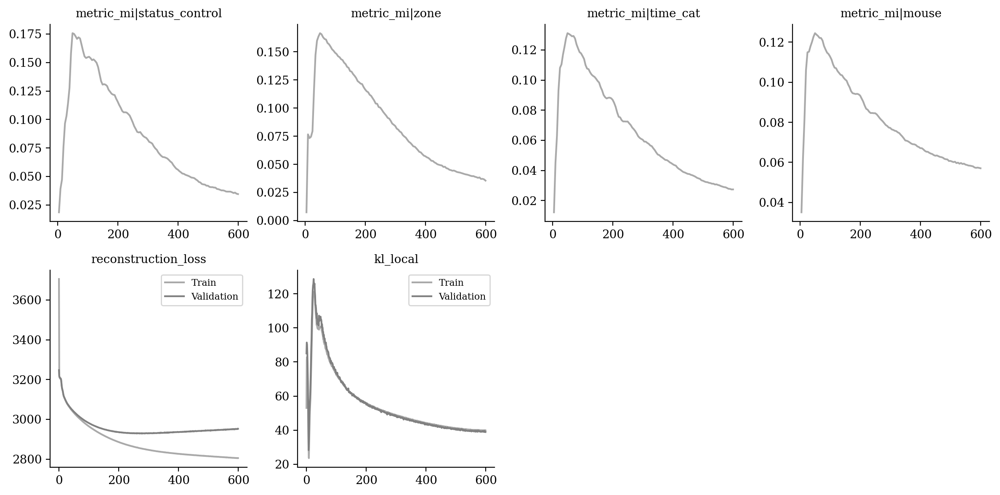

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

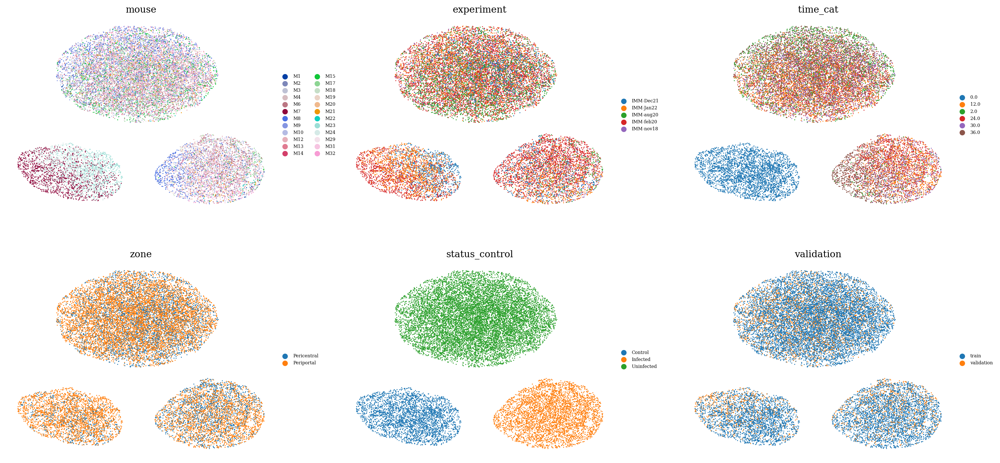

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

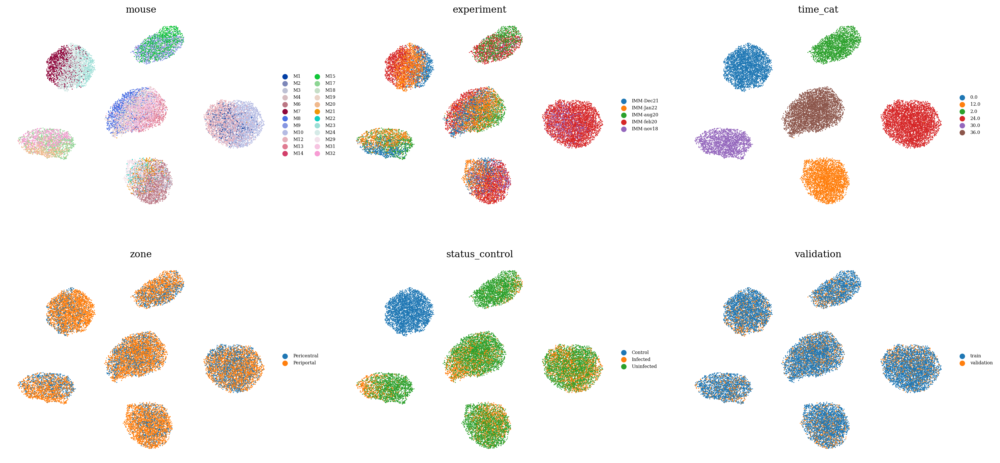

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

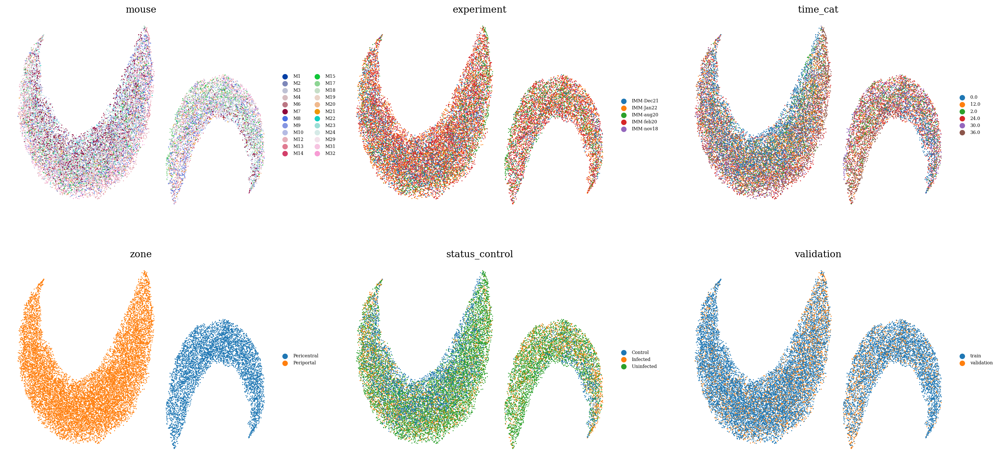

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

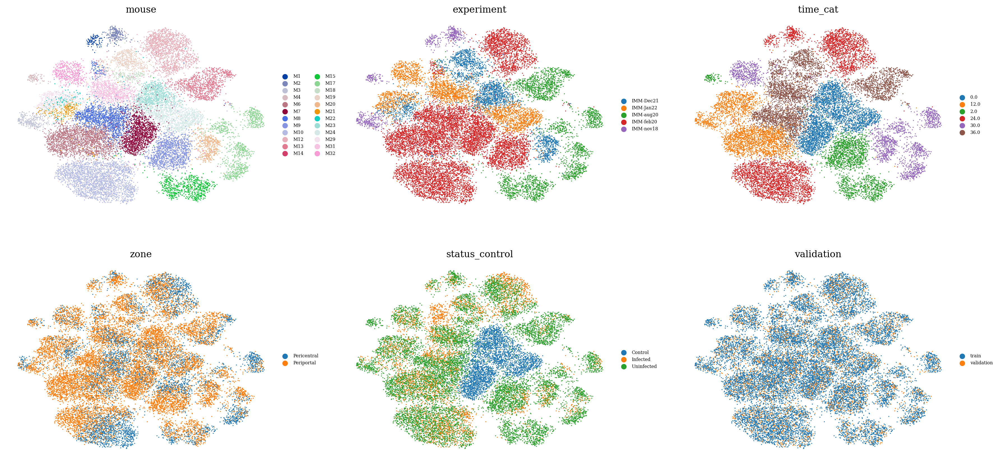

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

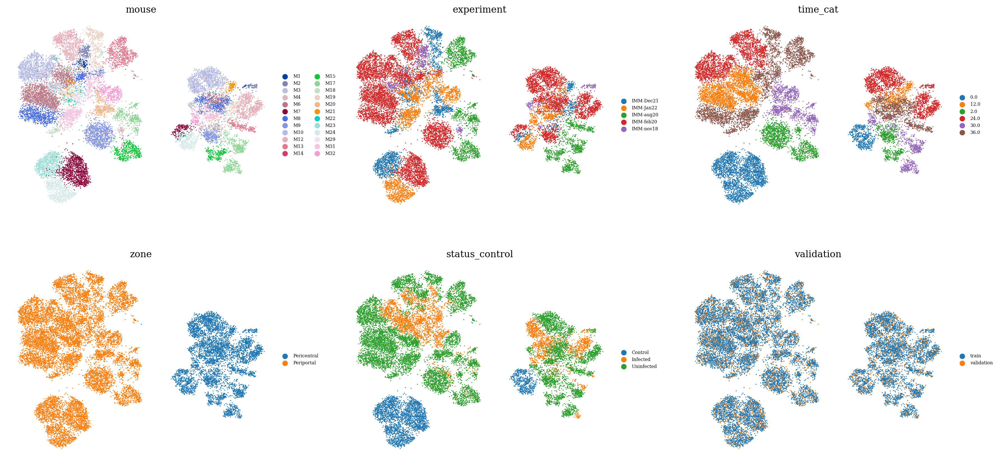

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

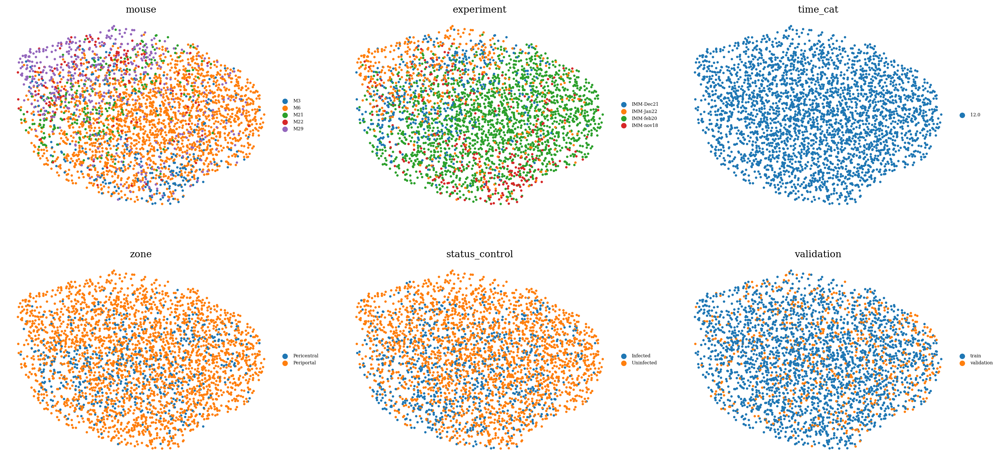

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )